In [2]:
import numpy as np
import pandas as pd

def calculate_bootstrap_mean_trend(cleaned_df, n_bootstrap_samples=100, sample_fraction=0.5):
    """
    Perform bootstrapping to compute the mean polynomial trend.

    Parameters:
    cleaned_df (pd.DataFrame): DataFrame containing the 'Weighted Δv/v' column.
    n_bootstrap_samples (int): Number of bootstrap samples.
    sample_fraction (float): Fraction of data to sample in each bootstrap.

    Returns:
    index_values (np.ndarray): Array of index values for plotting.
    mean_trend_values (np.ndarray): Array of mean trend values for plotting.
    """
    # Convert index to numerical values for fitting
    index_as_int = cleaned_df.index.astype(np.int64) // 10**9  # Convert to seconds to avoid overflow

    # Normalize index values to avoid overflow
    normalized_index = (index_as_int - index_as_int.min()) / (index_as_int.max() - index_as_int.min())

    # Initialize array to store the bootstrap results
    bootstrap_trends = np.zeros((n_bootstrap_samples, 2)) # 2 for slope and intercept

    # Perform bootstrapping
    for i in range(n_bootstrap_samples):
        # Resample with replacement
        resample_indices = np.random.choice(cleaned_df.index, size=int(len(cleaned_df) * sample_fraction), replace=True)
        resampled_df = cleaned_df.loc[resample_indices]
        
        # Convert resampled index to numerical values for fitting
        resampled_index_as_int = resampled_df.index.astype(np.int64) // 10**9
        resampled_normalized_index = (resampled_index_as_int - index_as_int.min()) / (index_as_int.max() - index_as_int.min())
        
        # Perform the polynomial fit
        z = np.polyfit(resampled_normalized_index, resampled_df['Weighted Δv/v'], 1)
        
        # Store the coefficients
        bootstrap_trends[i, :] = z

    # Calculate mean of the bootstrap results
    mean_trend_coefficients = np.mean(bootstrap_trends, axis=0)

    # Create the mean polynomial trend
    mean_trend = np.poly1d(mean_trend_coefficients)

    # Generate normalized index values for plotting
    normalized_index_values = np.linspace(normalized_index.min(), normalized_index.max(), len(index_as_int))
    mean_trend_values = mean_trend(normalized_index_values)

    # Convert normalized index values back to original scale
    index_values = normalized_index_values * (index_as_int.max() - index_as_int.min()) + index_as_int.min()

    # Convert index values back to datetime
    index_values = pd.to_datetime(index_values, unit='s')
    # Generate bootstrap trend lines
    bootstrap_trend_lines = np.array([np.poly1d(bootstrap_trends[i])(normalized_index_values) for i in range(n_bootstrap_samples)])

    return index_values, mean_trend_values, bootstrap_trend_lines

# Example usage:
#index_values, mean_trend_values = calculate_bootstrap_mean_trend(cleaned_df, index_as_int)


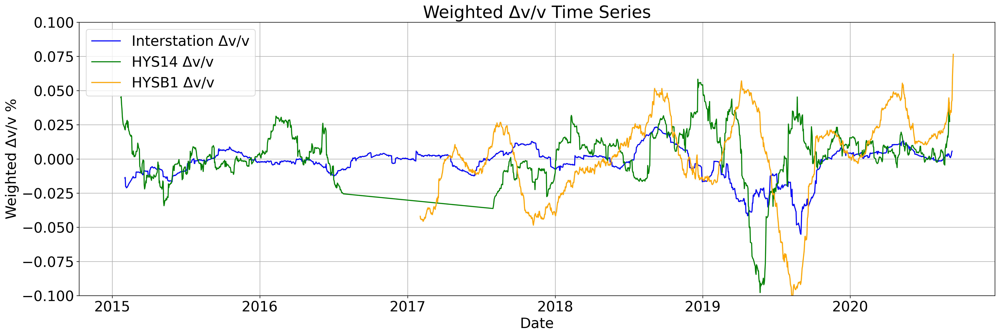

In [251]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the paths to your CSV files for all datasets
file_paths = {
    'Interstation Δv/v': ['HYS14B1_052ZZn.csv', 'HYS14B1_052ZZp.csv'],
    'HYS14 Δv/v': ['HYS14_13ZEp.csv', 'HYS14_13ZEn.csv'],
    'HYSB1 Δv/v': ['HYSB1_2019ZEp.csv', 'HYSB1_2019ZEn.csv'],
}

# Define the multipliers for each dataset
multipliers = {
    'Interstation Δv/v': [1, -1],
    'HYS14 Δv/v': [1, 1],
    'HYSB1 Δv/v': [-1, 1],
}

# Define offsets for each dataset
offsets = {
    'Interstation Δv/v': 30,  # days
    'HYS14 Δv/v': 20,        # days
    'HYSB1 Δv/v': 30,        # days
}

# Define exclusion ranges for each dataset
exclude_ranges = {
    'Interstation Δv/v': [("2023-10-01", "2024-01-30"), ("2010-01-10", "2011-08-05")],
    'HYS14 Δv/v': [("2017-02-15", "2017-07-10"), ("2016-07-07", "2017-02-16")],
    'HYSB1 Δv/v': [],  # No exclusion ranges for this example
}

# Setup the figure
plt.figure(figsize=(20, 7), dpi=300)
colors = ['blue', 'green', 'orange']  # Colors for each dataset

# Loop through each dataset
for i, (label, paths) in enumerate(file_paths.items()):
    dataframes = []
    for path, multiplier in zip(paths, multipliers[label]):
        # Load and process data
        df = pd.read_csv(path)
        df['DVT'] *= multiplier  # Apply multiplier
        df['T'] = pd.to_datetime(df['T'])fo
        df.set_index('T', inplace=True)
        dataframes.append(df)

    # Create a unified time index
    unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))
    interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

    # Exclude specified date ranges
    for start, end in exclude_ranges[label]:
        start_date = pd.to_datetime(start)
        end_date = pd.to_datetime(end)
        for j in range(len(interpolated_dfs)):
            interpolated_dfs[j] = interpolated_dfs[j].drop(interpolated_dfs[j].loc[start_date:end_date].index)

    # Calculate weighted Δv/v for the current dataset
    CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)
    weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

    # Create a DataFrame for weighted Δv/v
    weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
    weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=offsets[label])

    # Plot the weighted Δv/v
    plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], color=colors[i], label=label)

# Finalize plot
plt.xlabel('Date')
plt.ylabel('Weighted Δv/v %')
plt.ylim([-0.1, 0.1])
plt.title('Weighted Δv/v Time Series')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
## import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define the paths to your CSV files for all datasets
file_paths = {
    'HYS14 1-3Hz Δv/v': ['HYS14_13ZEp.csv', 'HYS14_13ZEn.csv'],
    'HYSB1 3-5Hz Δv/v': ['HYSB1_2019ZEp.csv', 'HYSB1_2019ZEn.csv'],
    'HYS14 3-5Hz Δv/v': ['HYS14_35ZEp3.csv', 'HYS14_35ZEn3.csv',],
    'HYS12 1-3Hz Δv/v': ['HYS12_13ZEp1.csv','HYS12_13ZEn1.csv',],
#    'HYS14 0.1-0.3Hz Δv/v':['HYS14_0103ZEp.csv', 'HYS14_0103ZEn.csv',]
}

# Define the multipliers for each dataset
multipliers = {
    'HYS14 1-3Hz Δv/v': [1, 1],
    'HYSB1 3-5Hz Δv/v': [-1, 1],
    'HYS14 3-5Hz Δv/v': [-1,1],
    'HYS12 1-3Hz Δv/v': [1,1],
#    'HYS14 0.1-0.3Hz Δv/v':[-1,1]
}

# Define offsets for each dataset
offsets = {
    'HYS14 1-3Hz Δv/v': 20,        # days
    'HYSB1 3-5Hz Δv/v': 30,        # days
    'HYS14 3-5Hz Δv/v': 20,
    'HYS12 1-3Hz Δv/v':30,
#    'HYS14 0.1-0.3Hz Δv/v':20
}

# Define exclusion ranges for each dataset
exclude_ranges = {
    'HYS14 1-3Hz Δv/v': [("2017-02-15", "2017-07-10"), ("2016-07-07", "2017-03-16")],
    'HYSB1 3-5Hz Δv/v': [],  # No exclusion ranges for this example
    'HYS14 3-5Hz Δv/v': [("2017-03-01", "2017-07-30"),("2016-08-01", "2017-03-16")],
    'HYS12 1-3Hz Δv/v':[],
#    'HYS14 0.1-0.3Hz Δv/v':[("2017-03-01", "2017-07-30"),("2016-08-01", "2017-03-16")]
}

# Setup the figure
plt.figure(figsize=(20, 7), dpi=300)
colors = ['blue', 'green', 'orange','maroon','cyan']  # Colors for each dataset

# Loop through each dataset
for i, (label, paths) in enumerate(file_paths.items()):
    dataframes = []
    for path, multiplier in zip(paths, multipliers[label]):
        # Load and process data
        df = pd.read_csv(path)
        df['DVT'] *= multiplier  # Apply multiplier
        df['T'] = pd.to_datetime(df['T'])
        df.set_index('T', inplace=True)
        dataframes.append(df)

    # Create a unified time index
    unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))
    interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

    # Exclude specified date ranges
    for start, end in exclude_ranges[label]:
        start_date = pd.to_datetime(start)
        end_date = pd.to_datetime(end)
        for j in range(len(interpolated_dfs)):
            interpolated_dfs[j] = interpolated_dfs[j].drop(interpolated_dfs[j].loc[start_date:end_date].index)

    # Calculate weighted Δv/v for the current dataset
    CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)
    weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

    # Create a DataFrame for weighted Δv/v
    weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
    weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=offsets[label])

    # Plot the weighted Δv/v
    plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], color=colors[i], label=label)

# Finalize plot
plt.xlabel('Date')
plt.ylabel('Weighted Δv/v %')
plt.ylim([-0.1, 0.1])
plt.title('Weighted Δv/v Time Series')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


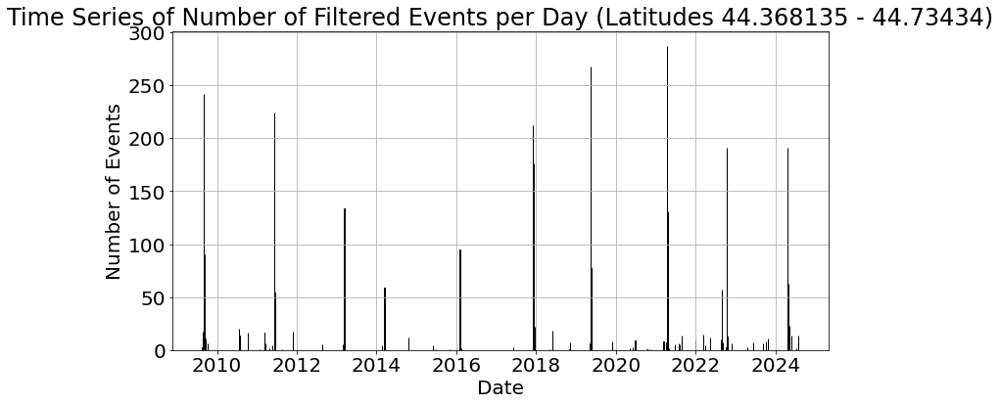

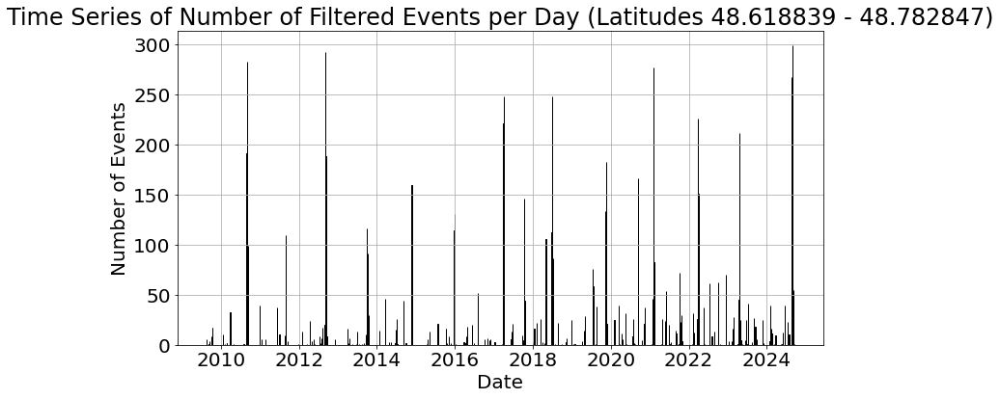

In [240]:
import pandas as pd
import matplotlib.pyplot as plt

# Load data from CSV files
filtered_events_lat_48 = pd.read_csv('filtered_events_per_day_lat_48.csv', index_col=0, parse_dates=True)
filtered_events_lat_44 = pd.read_csv('filtered_events_per_day_lat_44.csv', index_col=0, parse_dates=True)

# Plot the time series for latitudes 44.368135 - 44.73434
plt.figure(figsize=(12,6))
plt.bar(filtered_events_lat_44.index, filtered_events_lat_44['Number of Events'], width=1, edgecolor='black')
plt.title('Time Series of Number of Filtered Events per Day (Latitudes 44.368135 - 44.73434)')
plt.xlabel('Date')
plt.ylabel('Number of Events')
plt.grid(True)
plt.show()

# Plot the time series for latitudes 48.618839 - 48.782847
plt.figure(figsize=(12,6))
plt.bar(filtered_events_lat_48.index, filtered_events_lat_48['Number of Events'], width=1, edgecolor='black')
plt.title('Time Series of Number of Filtered Events per Day (Latitudes 48.618839 - 48.782847)')
plt.xlabel('Date')
plt.ylabel('Number of Events')
plt.grid(True)
plt.show()


In [239]:
# Initialize a dictionary to store the dates of the lowest values
lowest_values = {}

# Loop through each dataset
for label, paths in file_paths.items():
    dataframes = []
    for path, multiplier in zip(paths, multipliers[label]):
        # Load and process data
        df = pd.read_csv(path)
        df['DVT'] *= multiplier  # Apply multiplier
        df['T'] = pd.to_datetime(df['T'])
        df.set_index('T', inplace=True)
        dataframes.append(df)

    # Create a unified time index
    unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))
    interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

    # Exclude specified date ranges
    for start, end in exclude_ranges[label]:
        start_date = pd.to_datetime(start)
        end_date = pd.to_datetime(end)
        for j in range(len(interpolated_dfs)):
            interpolated_dfs[j] = interpolated_dfs[j].drop(interpolated_dfs[j].loc[start_date:end_date].index)

    # Calculate weighted Δv/v for the current dataset
    CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)
    weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

    # Create a DataFrame for weighted Δv/v
    weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
    weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=offsets[label])

    # Find the date of the lowest value
    min_value_date = weighted_dvv_df['Weighted Δv/v'].idxmin()
    min_value = weighted_dvv_df['Weighted Δv/v'].min()

    # Store the result
    lowest_values[label] = (min_value_date, min_value)

# Print the results
for label, (date, value) in lowest_values.items():
    print(f"{label}: Lowest value is {value:.5f} on {date.date()}")


Interstation Δv/v: Lowest value is -0.05512 on 2019-09-01
HYS14 Δv/v: Lowest value is -0.09777 on 2019-05-23
HYSB1 Δv/v: Lowest value is -0.10060 on 2019-08-12


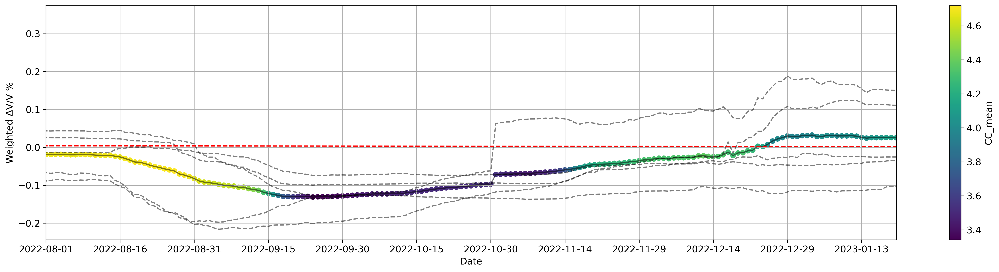

In [37]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYSB1_addonNE_negative.csv',
    'HYSB1_addonZE_positive.csv',
    'HYSB1_addonZN_negative.csv',
    'HYSB1_addonZN_positive.csv',
    'HYSB1_addonNE_positive.csv'
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, -1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting section
plt.figure(figsize=(20, 5), dpi=300)

# Step 1: Plot each individual DVT time series in black without applying CC
for df in interpolated_dfs:
    plt.plot(df.index+pd.DateOffset(days=30), df['DVT'], color='black', alpha=0.5, linestyle='--', label='Individual Time Series')

# Step 2: Plot the weighted Δv/v time series with color-coded CC_mean
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Plot labels and customization
plt.xlabel('Date')
plt.ylabel('Weighted ΔV/V %')
plt.grid(True)
start_date = pd.to_datetime("2022-08-01")
end_date = pd.to_datetime("2023-01-20")
plt.xlim([start_date, end_date])
plt.xticks(pd.date_range(start=start_date, end=end_date, freq='15D'))

# Show the plot
plt.tight_layout()
plt.show()


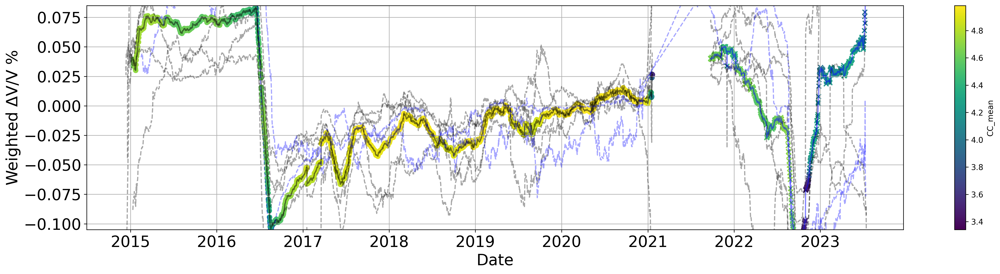

In [12]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths_1 = [
    'B1_60daystack_3p0to5p0 negativeZE 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZE 210svd7x.csv',
    'B1_60daystack_3p0to5p0 negativeZN 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZN 210svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveNE 210svd7x.csv',
]

file_paths_2 = [
    'HYSB1_addonNE_negative.csv',
    'HYSB1_addonZE_positive.csv',
    'HYSB1_addonZN_negative.csv',
    'HYSB1_addonZN_positive.csv',
    'HYSB1_addonNE_positive.csv',
]

file_paths_3 = [
    'HYSB1_NE35n1_10.csv',
    'HYSB1_ZE35p1_10.csv'
]

file_paths_4 = [
    'B1_60daystack_3p0to5p0 negativeNE 102svd7x.csv',
]

# Predefined arrays with multipliers (-1 or +1)
multipliers_1 = [1, 1, 1, 1, 1,-1]
multipliers_2 = [1, 1, -1, 1, 1]
multipliers_3 = [1, 1]
multipliers_4 = [-1]

def process_files(file_paths, multipliers):
    dataframes = []
    for path, multiplier in zip(file_paths, multipliers):
        df = pd.read_csv(path)
        df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
        dataframes.append(df)

    # Parse timestamps and set them as the index
    for df in dataframes:
        df['T'] = pd.to_datetime(df['T'])
        df.set_index('T', inplace=True)

    # Create a unified time index from the union of all timestamps in the dataframes
    unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

    # Interpolate data for each dataframe to match the unified index
    interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

    # Calculate CC_mean using squared correlation coefficients for each time point
    CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

    # Calculate weighted Δu/u using squared CCT and DVT
    weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

    # Create a DataFrame for the weighted Δv/v time series
    weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
    weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

    return interpolated_dfs, weighted_dvv_df, CC_mean

# Process all sets of files
interpolated_dfs_1, weighted_dvv_df_1, CC_mean_1 = process_files(file_paths_1, multipliers_1)
interpolated_dfs_2, weighted_dvv_df_2, CC_mean_2 = process_files(file_paths_2, multipliers_2)
interpolated_dfs_3, _, _ = process_files(file_paths_3, multipliers_3)

# Combine CC_mean for a common colorbar scale
combined_CC_mean = pd.concat([CC_mean_1, CC_mean_2])
norm = mcolors.Normalize(vmin=combined_CC_mean.min(), vmax=combined_CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Plotting section
plt.figure(figsize=(20, 5), dpi=300)

# Step 1: Plot each individual DVT time series in black without applying CC
for df in interpolated_dfs_1:
    df.index = df.index + pd.DateOffset(days=30)
    plt.plot(df.index, df['DVT'], color='black', alpha=0.35, linestyle='--', label='Individual Time Series (Set 1)')
for df in interpolated_dfs_2:
    df.index = df.index + pd.DateOffset(days=30)
    plt.plot(df.index, df['DVT'], color='black', alpha=0.35, linestyle='--', label='Individual Time Series (Set 2)')

# Step 2: Plot the weighted Δv/v time series from the first set of files with color-coded CC_mean
sc1 = plt.scatter(weighted_dvv_df_1.index, weighted_dvv_df_1['Weighted Δv/v'], c=CC_mean_1, cmap=cmap, norm=norm, label='Weighted Δv/v (Set 1)')
plt.plot(weighted_dvv_df_1.index, weighted_dvv_df_1['Weighted Δv/v'], 'k-', alpha=0.5)  # Line plot to connect markers

# Step 3: Plot the weighted Δv/v time series from the second set of files with color-coded CC_mean
sc2 = plt.scatter(weighted_dvv_df_2.index, weighted_dvv_df_2['Weighted Δv/v'], c=CC_mean_2, cmap=cmap, norm=norm, label='Weighted Δv/v (Set 2)', marker='x')
plt.plot(weighted_dvv_df_2.index, weighted_dvv_df_2['Weighted Δv/v'], 'b-', alpha=0.5)  # Line plot to connect markers

# Step 4: Plot each individual Δv/v time series from the third set of files in red without color-coding
for i, df in enumerate(interpolated_dfs_3):
    df.index = df.index + pd.DateOffset(days=30)
    if i == 0:
        df['DVT'] = df['DVT'] / 5  # Adjust the first file of the third set
    plt.plot(df.index, df['DVT'], color='blue', alpha=0.35, linestyle='--', label='Individual Time Series (Set 3)')

# Add a single colorbar for both sets
plt.colorbar(sc2, label='CC_mean')

# Plot labels and customization
plt.xlabel('Date', fontsize=20)
plt.ylabel('Weighted ΔV/V %', fontsize=20)
plt.grid(True)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.ylim([-0.105,0.085])

# Show the plot
plt.tight_layout()
plt.show()


In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths_1 = [
    'B1_60daystack_3p0to5p0 negativeZE 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZE 210svd7x.csv',
    'B1_60daystack_3p0to5p0 negativeZN 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZN 210svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveNE 210svd7x.csv',
]

file_paths_2 = [
    'HYSB1_addonNE_negative.csv',
    'HYSB1_addonZE_positive.csv',
    'HYSB1_addonZN_negative.csv',
    'HYSB1_addonZN_positive.csv',
    'HYSB1_addonNE_positive.csv'
]

file_paths_3 = [
    'HYSB1_NE35n1_10.csv',
    'HYSB1_ZE35p1_10.csv'
]

file_paths_4 = [
    'B1_60daystack_3p0to5p0 negativeNE 102svd7x.csv'
]
file_paths_5 = [
    'HYSB1_addonZE_negative.csv'
]
    
# Predefined arrays with multipliers (-1 or +1)
multipliers_1 = [1, 1, 1, 1, 1,-1]
multipliers_2 = [1, 1, -1, 1, 1]
multipliers_3 = [1, 1]
multipliers_4 = [-1]
multipliers_5 = [1]

def process_files(file_paths, multipliers):
    dataframes = []
    for path, multiplier in zip(file_paths, multipliers):
        df = pd.read_csv(path)
        df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
        dataframes.append(df)

    # Parse timestamps and set them as the index
    for df in dataframes:
        df['T'] = pd.to_datetime(df['T'])
        df.set_index('T', inplace=True)

    # Create a unified time index from the union of all timestamps in the dataframes
    unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

    # Interpolate data for each dataframe to match the unified index
    interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

    # Calculate CC_mean using squared correlation coefficients for each time point
    CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

    # Calculate weighted Δu/u using squared CCT and DVT
    weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

    # Create a DataFrame for the weighted Δv/v time series
    weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
    weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

    return interpolated_dfs, weighted_dvv_df, CC_mean

# Process all sets of files
interpolated_dfs_1, weighted_dvv_df_1, CC_mean_1 = process_files(file_paths_1, multipliers_1)
interpolated_dfs_2, weighted_dvv_df_2, CC_mean_2 = process_files(file_paths_2, multipliers_2)
interpolated_dfs_3, _, _ = process_files(file_paths_3, multipliers_3)
interpolated_dfs_4, _, _ = process_files(file_paths_4, multipliers_4)
interpolated_dfs_5, _, _ = process_files(file_paths_5, multipliers_5)

# Combine CC_mean for a common colorbar scale
combined_CC_mean = pd.concat([CC_mean_1, CC_mean_2])
norm = mcolors.Normalize(vmin=combined_CC_mean.min(), vmax=combined_CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Plotting section
plt.figure(figsize=(20, 5), dpi=300)

# Step 1: Plot each individual DVT time series in black without applying CC
for df in interpolated_dfs_1:
    df.index = df.index + pd.DateOffset(days=30)
    plt.plot(df.index, df['DVT'], color='black', alpha=0.35, linestyle='--', label='Individual Time Series (Set 1)')
for df in interpolated_dfs_2:
    df.index = df.index + pd.DateOffset(days=30)
    plt.plot(df.index, df['DVT'], color='black', alpha=0.35, linestyle='--', label='Individual Time Series (Set 2)')

# Step 2: Plot the weighted Δv/v time series from the first set of files with color-coded CC_mean
sc1 = plt.scatter(weighted_dvv_df_1.index, weighted_dvv_df_1['Weighted Δv/v'], c=CC_mean_1, cmap=cmap, norm=norm, label='Weighted Δv/v (Set 1)')
plt.plot(weighted_dvv_df_1.index, weighted_dvv_df_1['Weighted Δv/v'], 'k-', alpha=0.5)  # Line plot to connect markers

# Step 3: Plot the weighted Δv/v time series from the second set of files with color-coded CC_mean
sc2 = plt.scatter(weighted_dvv_df_2.index, weighted_dvv_df_2['Weighted Δv/v'], c=CC_mean_2, cmap=cmap, norm=norm, label='Weighted Δv/v (Set 2)', marker='x')
plt.plot(weighted_dvv_df_2.index, weighted_dvv_df_2['Weighted Δv/v'], 'b-', alpha=0.5)  # Line plot to connect markers

# Step 4: Plot each individual Δv/v time series from the third set of files in blue without color-coding
for i, df in enumerate(interpolated_dfs_3):
    df.index = df.index + pd.DateOffset(days=30)
    if i == 0:
        df['DVT'] = df['DVT'] / 5  # Adjust the first file of the third set
    plt.plot(df.index, df['DVT'], color='blue', alpha=0.35, linestyle='--', label='Individual Time Series (Set 3)')

# Step 5: Plot each individual Δv/v time series from the fourth set of files in red
for df in interpolated_dfs_4:
    df.index = df.index + pd.DateOffset(days=30)
    plt.plot(df.index, df['DVT'], color='green', alpha=0.35, linestyle='--', label='Individual Time Series (Set 4)')

# Step 6: Plot each individual Δv/v time series from the fifth set of files in green
for df in interpolated_dfs_5:
    df.index = df.index + pd.DateOffset(days=30)
    plt.plot(df.index, df['DVT'], color='green', alpha=0.35, linestyle='--', label='Individual Time Series (Set 5)')

# Add a single colorbar for both sets
plt.colorbar(sc2, label='CC_mean')

# Plot labels and customization
plt.xlabel('Date', fontsize=20)
plt.ylabel('Weighted ΔV/V %', fontsize=20)
plt.grid(True)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.ylim([-0.1,0.1])

# Show the plot
plt.tight_layout()
plt.show()


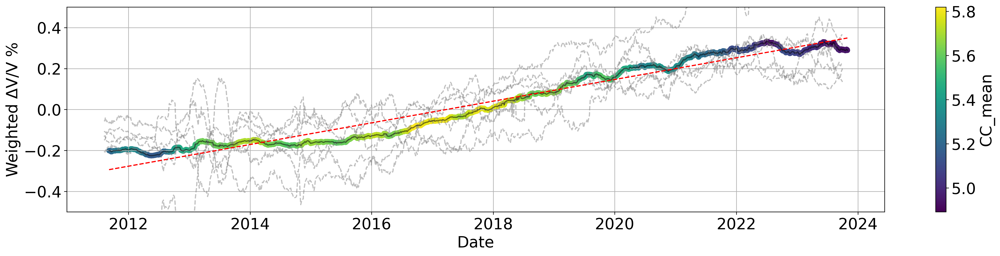

In [55]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveNZ 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeNZ 102svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveNE 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeNE 102svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveZE 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeZE 102svd7.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
exclude_ranges = [("2023-10-01", "2024-01-30"), ("2010-01-10", "2011-08-05")]
for start, end in exclude_ranges:
    start_date = pd.to_datetime(start)
    end_date = pd.to_datetime(end)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(20, 5), dpi=300)

# Plot each individual dataframe on the same graph with black dashed lines
for path, df in zip(file_paths, interpolated_dfs):
    plt.plot(df.index, df['DVT'], color='grey', alpha=0.5, linestyle='--', label=f'DVT - {path.split("/")[-1]}')

# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')


# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

plt.xlabel('Date')
plt.ylim([-0.5, 0.5])
plt.ylabel('Weighted ΔV/V %')
plt.grid(True)
plt.rcParams.update({'font.size': 20})
plt.tight_layout()
plt.show()


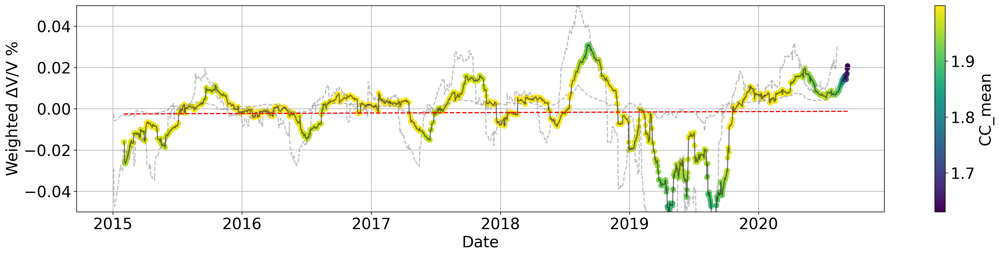

In [214]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYS14B1_052ZZn.csv',
    'HYS14B1_052ZZp.csv'
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, -1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
exclude_ranges = [("2023-10-01", "2024-01-30"), ("2010-01-10", "2011-08-05")]
for start, end in exclude_ranges:
    start_date = pd.to_datetime(start)
    end_date = pd.to_datetime(end)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(20, 5), dpi=300)

# Plot each individual dataframe on the same graph with black dashed lines
for path, df in zip(file_paths, interpolated_dfs):
    plt.plot(df.index, df['DVT'], color='grey', alpha=0.5, linestyle='--', label=f'DVT - {path.split("/")[-1]}')

# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')


# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

plt.xlabel('Date')
plt.ylim([-0.05, 0.05])
plt.ylabel('Weighted ΔV/V %')
plt.grid(True)
plt.rcParams.update({'font.size': 20})
plt.tight_layout()
plt.show()


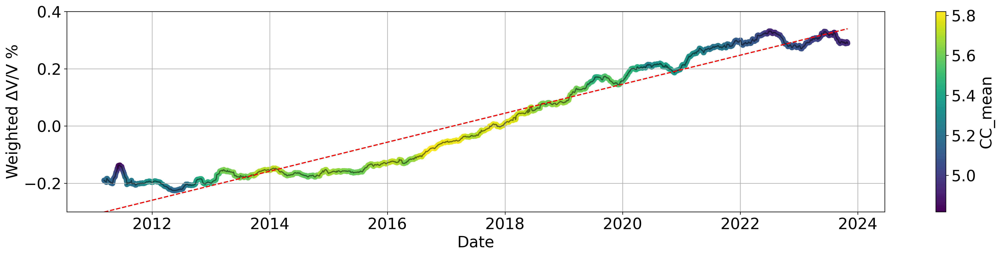

In [34]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import pandas as pd

# Define the paths to your CSV files
file_paths = [
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveNZ 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeNZ 102svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveNE 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeNE 102svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveZE 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeZE 102svd7.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2023-10-01")
end_date = pd.to_datetime("2024-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2010-01-10")
end_date = pd.to_datetime("2011-02-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(20, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.3,0.4])
plt.ylabel('Weighted ΔV/V %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
start_date = pd.to_datetime("2010-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 20})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

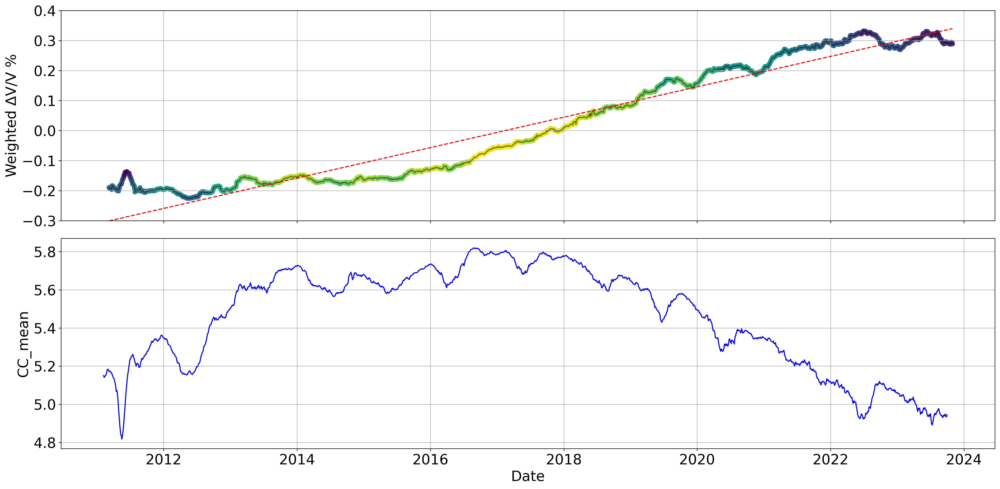

In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveNZ 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeNZ 102svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveNE 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeNE 102svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveZE 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeZE 102svd7.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Exclude the specified date ranges
exclude_ranges = [
    (pd.to_datetime("2023-10-01"), pd.to_datetime("2024-01-30")),
    (pd.to_datetime("2010-01-10"), pd.to_datetime("2011-02-05"))
]

for start_date, end_date in exclude_ranges:
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

# Adjust index to center dates (if needed)
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Create figure with two subplots
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 10), dpi=300, sharex=True)

# Plot weighted Δv/v time series with color-coded CC_mean on ax1
sc = ax1.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm)
ax1.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)
#cbar = fig.colorbar(sc, ax=ax1)
#cbar.set_label('CC_mean')
ax1.set_ylim([-0.3, 0.4])
ax1.set_ylabel('Weighted ΔV/V %')
ax1.grid(True)

# Adding a trend line to ax1
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
ax1.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Plot CC_mean vs time on ax2
ax2.plot(CC_mean.index, CC_mean, 'b-')
ax2.set_ylabel('CC_mean')
ax2.grid(True)

# Set x-axis label on the bottom subplot
ax2.set_xlabel('Date')

# Adjust font size and layout
plt.rcParams.update({'font.size': 20})
plt.tight_layout()
plt.show()


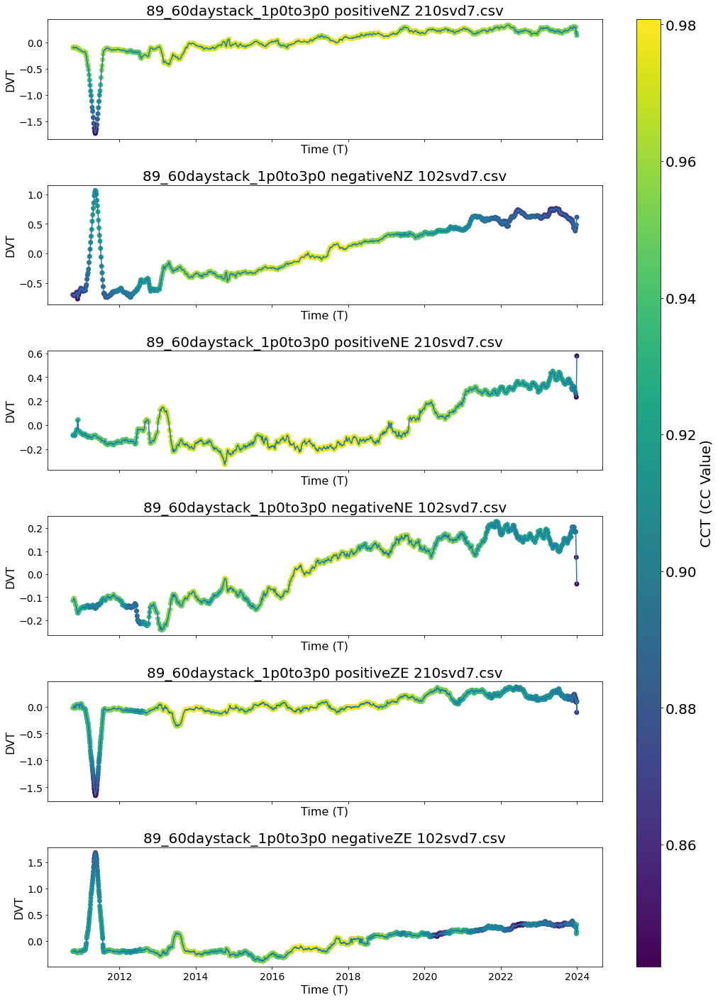

In [88]:
import pandas as pd
import matplotlib.pyplot as plt
import os

file_paths = [
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveNZ 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeNZ 102svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveNE 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeNE 102svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 positiveZE 210svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_1p0to3p0 negativeZE 102svd7.csv',
]

# Predefined array of inversion switches
inversion_array = [1,1, 1, 1, 1, 1]

start_date = pd.to_datetime("2015-01-01")
end_date = pd.to_datetime("2021-01-01")

# Create a figure with 6 subplots (3 rows and 2 columns)
fig, axs = plt.subplots(len(file_paths), 1, figsize=(15, len(file_paths)*3.33), sharex=True, sharey=False)

# Flatten the array of axes for easier iteration
axs = axs.flatten()

for idx, file_path in enumerate(file_paths):
    # Load the data
    data = pd.read_csv(file_path)
    
    # Convert the 'T' column to datetime format if necessary
    data['T'] = pd.to_datetime(data['T'])
    
    # Apply inversion based on the predefined array
    data['DVT'] *= inversion_array[idx]
    
    # Plotting scatter and line on the corresponding subplot
    scatter = axs[idx].scatter(data['T'], data['DVT'], c=data['CCT'], cmap='viridis', label='Scatter')
    axs[idx].plot(data['T'], data['DVT'], label='Line')
    
    # Set title and labels for each subplot
    axs[idx].set_title(os.path.basename(file_path), fontsize=20)
    axs[idx].set_xlabel('Time (T)', fontsize=16)
    axs[idx].set_ylabel('DVT', fontsize=16)
    axs[idx].tick_params(axis='both', which='major', labelsize=14)
    #axs[idx].set_xlim([start_date, end_date])  # Set x-axis limits
    #axs[idx].set_ylim([-0.3, 0.3])  # Set x-axis limits

# Adjust subplot layout
plt.tight_layout()
#plt.ylim([-1.0,1.0])

# Add a color bar in the figure
fig.colorbar(scatter, ax=axs, orientation='vertical', label='CCT (CC Value)', aspect=40)

# Show the plot
plt.show()


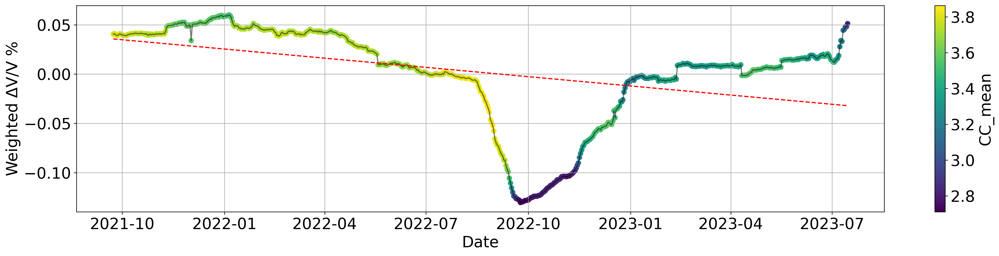

In [196]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    'HYSB1_addonNE_negative.csv',
    'HYSB1_addonZE_positive.csv',
    'HYSB1_addonZN_negative.csv',
    'HYSB1_addonZN_positive.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, -1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)
weighted_dvv_df['Weighted Δv/v'][403:420]
# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(20, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
#plt.ylim([-0.1,0.1])
plt.ylabel('Weighted ΔV/V %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
start_date = pd.to_datetime("2010-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 20})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

In [197]:
T=weighted_dvv_df.index
D=weighted_dvv_df['Weighted Δv/v']
C=CC_mean
#D[403:630]=D[403:630]-0.03
D[70]=D[69]

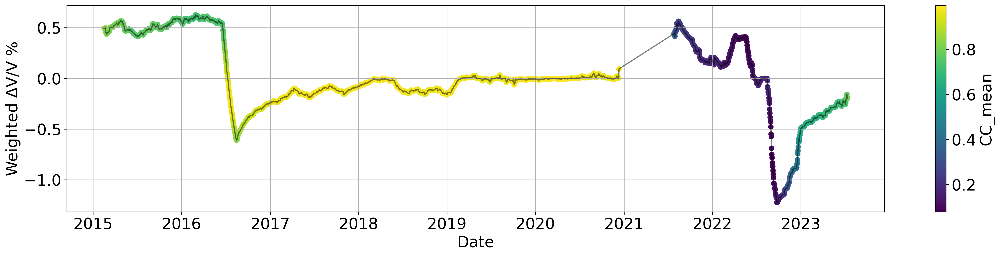

In [14]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    'HYSB1_NE35n1_10.csv'
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, 1, 1, 1,1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)
weighted_dvv_df['Weighted Δv/v'][403:420]
# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(20, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
#plt.ylim([-0.1,0.1])
plt.ylabel('Weighted ΔV/V %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

#plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
start_date = pd.to_datetime("2010-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 20})
T1=weighted_dvv_df.index
D1=weighted_dvv_df['Weighted Δv/v']
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

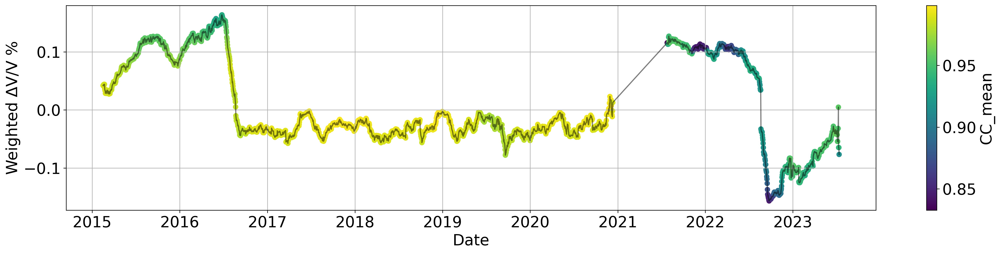

In [200]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    'HYSB1_ZE35p1_10.csv'
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, 1, 1, 1,1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)
weighted_dvv_df['Weighted Δv/v'][403:420]
# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(20, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
#plt.ylim([-0.1,0.1])
plt.ylabel('Weighted ΔV/V %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

#plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
start_date = pd.to_datetime("2010-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 20})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

In [201]:
T2=weighted_dvv_df.index
D2=weighted_dvv_df['Weighted Δv/v']

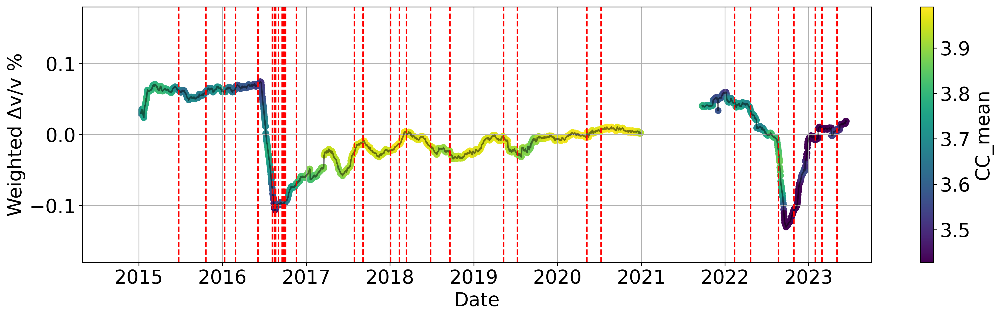

In [159]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_3p0to5p0 negativeZE 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZE 210svd7x.csv',
    'B1_60daystack_3p0to5p0 negativeZN 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZN 210svd7x.csv'
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-12-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with PGV on a separate y-axis
fig, ax1 = plt.subplots(figsize=(16, 5), dpi=300)

# Scatter plot for Δv/v with color coding by CC_mean
sc = ax1.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')

ax1.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Line plot to connect markers
ax1.scatter(T[0:630], D[0:630], c=C[0:630], cmap=cmap, norm=norm, label='Weighted Δv/v')
ax1.plot(T[0:630], D[0:630], 'k-', alpha=0.5)  # Line plot to connect markers
plt.colorbar(sc, label='CC_mean')
ax1.set_xlabel('Date')
ax1.set_ylabel('Weighted Δv/v %')
ax1.set_ylim([-0.18, 0.18])
ax1.grid(True)
plt.rcParams.update({'font.size': 20})  # Increase font size
for dt in datetime_objects:
    ax1.axvline(x=dt, color='red', linestyle='--')

# Add color bar for CC_mean
#cbar = fig.colorbar(sc, ax=ax1, label='CC_mean')
plt.rcParams.update({'font.size': 20})
start_date = pd.to_datetime("2014-05-01")
end_date = pd.to_datetime("2023-10-01")
plt.rcParams.update({'font.size': 20})
plt.xlim([start_date, end_date])
# Show the plot
fig.tight_layout()
plt.show()

NameError: name 'T' is not defined

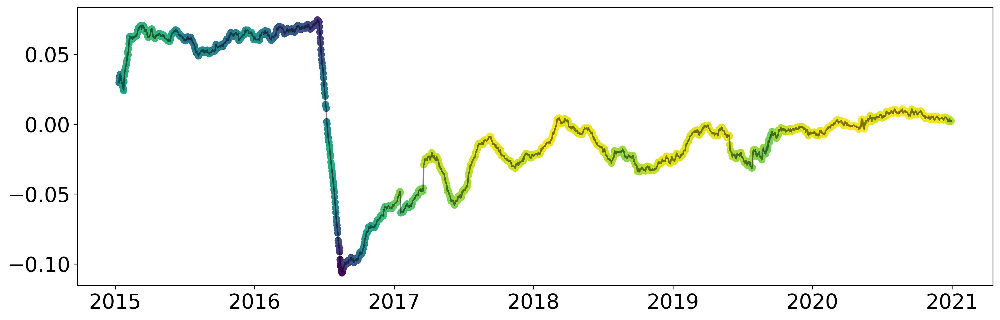

In [24]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_3p0to5p0 negativeZE 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZE 210svd7x.csv',
    'B1_60daystack_3p0to5p0 negativeZN 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZN 210svd7x.csv'
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-12-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with PGV on a separate y-axis
fig, ax1 = plt.subplots(figsize=(16, 5), dpi=300)

# Scatter plot for Δv/v with color coding by CC_mean
sc = ax1.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')

ax1.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Line plot to connect markers
ax1.scatter(T[0:630], D[0:630], c=C[0:630], cmap=cmap, norm=norm, label='Weighted Δv/v')
ax1.plot(T[0:630], D[0:630], 'k-', alpha=0.5)  # Line plot to connect markers
plt.colorbar(sc, label='CC_mean')
ax1.set_xlabel('Date')
ax1.set_ylabel('Weighted Δv/v %')
ax1.set_ylim([-0.18, 0.18])
ax1.grid(True)
plt.rcParams.update({'font.size': 20})  # Increase font size
#for dt in datetime_objects:
#    ax1.axvline(x=dt, color='red', linestyle='--')

# Add color bar for CC_mean
#cbar = fig.colorbar(sc, ax=ax1, label='CC_mean')
plt.rcParams.update({'font.size': 20})
start_date = pd.to_datetime("2014-05-01")
end_date = pd.to_datetime("2023-10-01")
plt.rcParams.update({'font.size': 20})
plt.xlim([start_date, end_date])
# Show the plot
fig.tight_layout()
plt.show()

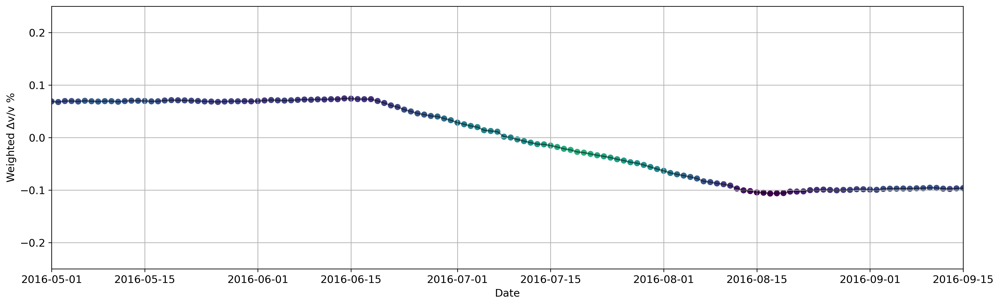

In [30]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_3p0to5p0 negativeZE 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZE 210svd7x.csv',
    'B1_60daystack_3p0to5p0 negativeZN 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZN 210svd7x.csv'
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-12-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with CC_mean on a secondary y-axis
fig, ax1 = plt.subplots(figsize=(16, 5), dpi=300)

# Scatter plot for Δv/v with color coding by CC_mean
sc = ax1.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')

ax1.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Line plot to connect markers
##ax1.scatter(T[0:630], D[0:630], c=C[0:630], cmap=cmap, norm=norm, label='Weighted Δv/v')
#ax1.plot(T[0:630], D[0:630], 'k-', alpha=0.5)  # Line plot to connect markers
#ax1.plot(T1, D1/5, 'k-', alpha=0.5)  # Line plot to connect markers
#ax1.plot(T2, D2, 'k-', alpha=0.5)  # Line plot to connect markers
ax1.set_xlabel('Date')
ax1.set_ylabel('Weighted Δv/v %')
ax1.set_ylim([-0.25, 0.25])
ax1.grid(True)
plt.rcParams.update({'font.size': 12})  # Increase font size

# Create a second y-axis for CC_mean
#ax2 = ax1.twinx()
#ax2.plot(weighted_dvv_df.index, CC_mean, color='red', label='CC_mean')
#ax2.plot(T[0:630],C[0:630],color='red', label='CC_mean')
#ax2.set_ylabel('CC_mean', color='red')
#ax2.tick_params(axis='y', labelcolor='red')

# Add color bar for CC_mean
#plt.colorbar(sc, ax=ax1, label='CC_mean')

# Set the x-axis limits
start_date = pd.to_datetime("2016-05-01")
end_date = pd.to_datetime("2016-09-15")
plt.xlim([start_date, end_date])

# Show the plot
fig.tight_layout()
plt.show()


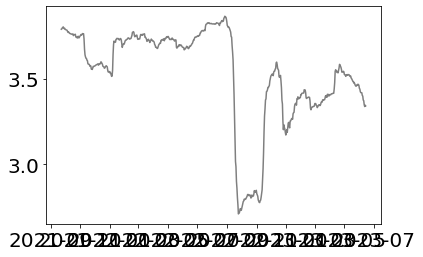

In [148]:
#plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Line plot to connect markers

plt.plot(T[0:630], C[0:630], 'k-', alpha=0.5)  # Line plot to connect markers


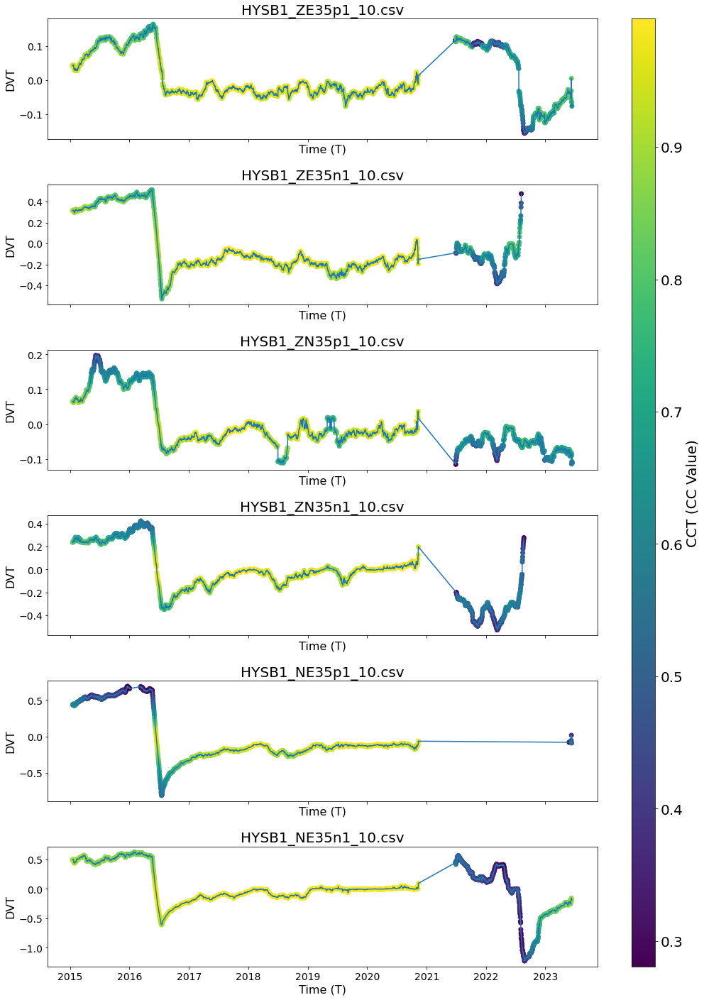

In [207]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# List of all file paths
file_paths = [
    'HYSB1_ZE35p1_10.csv',
    'HYSB1_ZE35n1_10.csv',
    'HYSB1_ZN35p1_10.csv',
    'HYSB1_ZN35n1_10.csv',
    'HYSB1_NE35p1_10.csv',
    'HYSB1_NE35n1_10.csv'
]

# Predefined array of inversion switches
inversion_array = [1,1, 1, 1, 1, 1]

start_date = pd.to_datetime("2015-01-01")
end_date = pd.to_datetime("2021-01-01")

# Create a figure with 6 subplots (3 rows and 2 columns)
fig, axs = plt.subplots(len(file_paths), 1, figsize=(15, len(file_paths)*3.33), sharex=True, sharey=False)

# Flatten the array of axes for easier iteration
axs = axs.flatten()

for idx, file_path in enumerate(file_paths):
    # Load the data
    data = pd.read_csv(file_path)
    
    # Convert the 'T' column to datetime format if necessary
    data['T'] = pd.to_datetime(data['T'])
    
    # Apply inversion based on the predefined array
    data['DVT'] *= inversion_array[idx]
    
    # Plotting scatter and line on the corresponding subplot
    scatter = axs[idx].scatter(data['T'], data['DVT'], c=data['CCT'], cmap='viridis', label='Scatter')
    axs[idx].plot(data['T'], data['DVT'], label='Line')
    
    # Set title and labels for each subplot
    axs[idx].set_title(os.path.basename(file_path), fontsize=20)
    axs[idx].set_xlabel('Time (T)', fontsize=16)
    axs[idx].set_ylabel('DVT', fontsize=16)
    axs[idx].tick_params(axis='both', which='major', labelsize=14)
    #axs[idx].set_xlim([start_date, end_date])  # Set x-axis limits
    #axs[idx].set_ylim([-0.3, 0.3])  # Set x-axis limits

# Adjust subplot layout
plt.tight_layout()
#plt.ylim([-1.0,1.0])

# Add a color bar in the figure
fig.colorbar(scatter, ax=axs, orientation='vertical', label='CCT (CC Value)', aspect=40)

# Show the plot
plt.show()


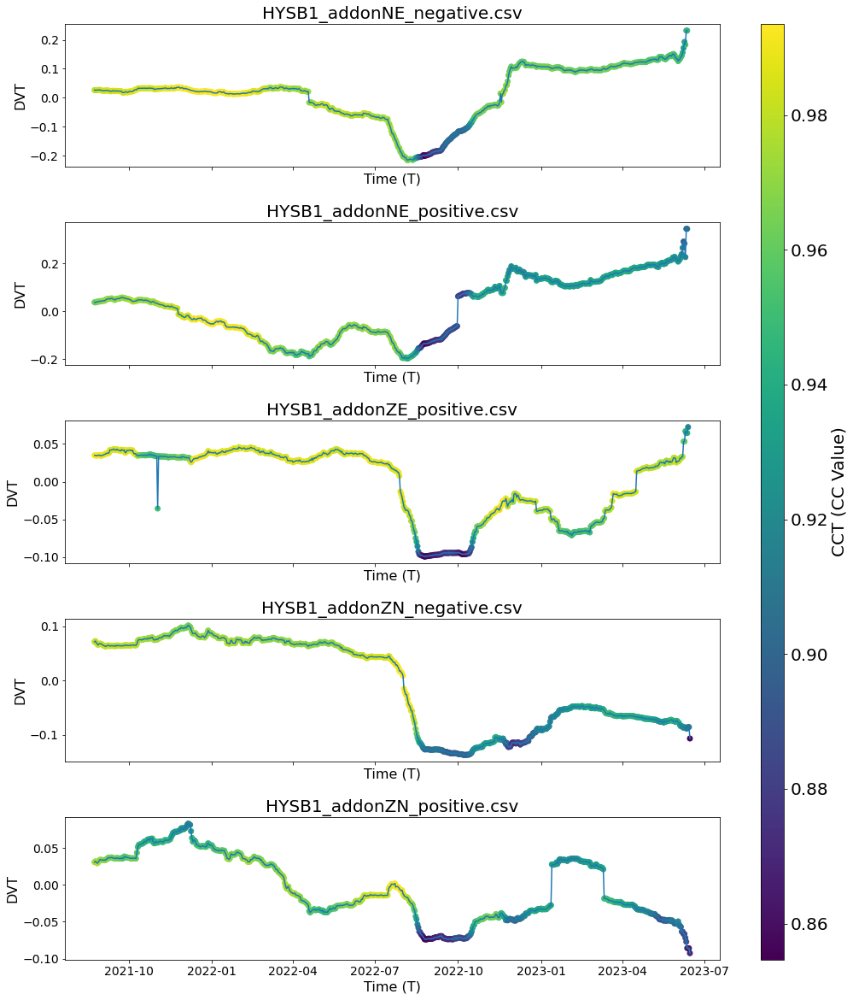

In [31]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# List of all file paths
file_paths = [
    'HYSB1_addonNE_negative.csv',
    'HYSB1_addonNE_positive.csv',
    'HYSB1_addonZE_positive.csv',
    'HYSB1_addonZN_negative.csv',
    'HYSB1_addonZN_positive.csv',
]

# Predefined array of inversion switches
inversion_array = [1,1, 1, -1, 1]

start_date = pd.to_datetime("2015-01-01")
end_date = pd.to_datetime("2021-01-01")

# Create a figure with 6 subplots (3 rows and 2 columns)
fig, axs = plt.subplots(len(file_paths), 1, figsize=(15, len(file_paths)*3.33), sharex=True, sharey=False)

# Flatten the array of axes for easier iteration
axs = axs.flatten()

for idx, file_path in enumerate(file_paths):
    # Load the data
    data = pd.read_csv(file_path)
    
    # Convert the 'T' column to datetime format if necessary
    data['T'] = pd.to_datetime(data['T'])
    
    # Apply inversion based on the predefined array
    data['DVT'] *= inversion_array[idx]
    
    # Plotting scatter and line on the corresponding subplot
    scatter = axs[idx].scatter(data['T'], data['DVT'], c=data['CCT'], cmap='viridis', label='Scatter')
    axs[idx].plot(data['T'], data['DVT'], label='Line')
    
    # Set title and labels for each subplot
    axs[idx].set_title(os.path.basename(file_path), fontsize=20)
    axs[idx].set_xlabel('Time (T)', fontsize=16)
    axs[idx].set_ylabel('DVT', fontsize=16)
    axs[idx].tick_params(axis='both', which='major', labelsize=14)
    #axs[idx].set_xlim([start_date, end_date])  # Set x-axis limits
    #axs[idx].set_ylim([-0.3, 0.3])  # Set x-axis limits

# Adjust subplot layout
plt.tight_layout()
#plt.ylim([-1.0,1.0])

# Add a color bar in the figure
fig.colorbar(scatter, ax=axs, orientation='vertical', label='CCT (CC Value)', aspect=40)

# Show the plot
plt.show()


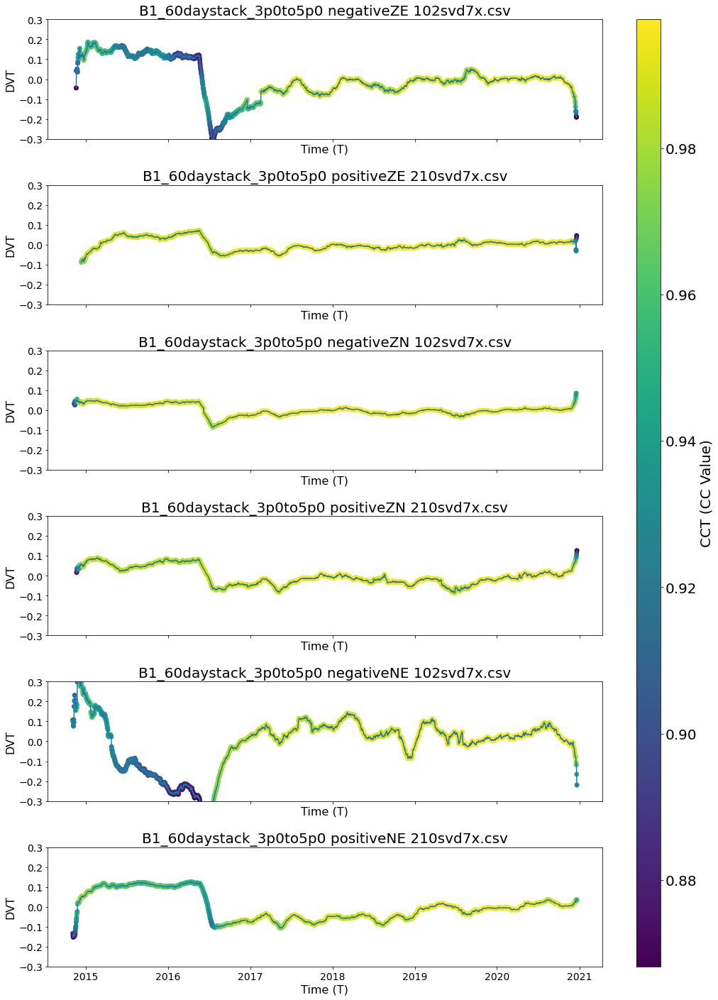

In [61]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# List of all file paths

file_paths = [
    'B1_60daystack_3p0to5p0 negativeZE 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZE 210svd7x.csv',
    'B1_60daystack_3p0to5p0 negativeZN 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZN 210svd7x.csv',
    'B1_60daystack_3p0to5p0 negativeNE 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveNE 210svd7x.csv',
]


# Predefined array of inversion switches
inversion_array = [1, 1, 1, 1, -1, 1]

start_date = pd.to_datetime("2015-01-01")
end_date = pd.to_datetime("2021-01-01")

# Create a figure with 6 subplots (3 rows and 2 columns)
fig, axs = plt.subplots(len(file_paths), 1, figsize=(15, len(file_paths)*3.33), sharex=True, sharey=False)

# Flatten the array of axes for easier iteration
axs = axs.flatten()

for idx, file_path in enumerate(file_paths):
    # Load the data
    data = pd.read_csv(file_path)
    
    # Convert the 'T' column to datetime format if necessary
    data['T'] = pd.to_datetime(data['T'])
    
    # Apply inversion based on the predefined array
    data['DVT'] *= inversion_array[idx]
    
    # Plotting scatter and line on the corresponding subplot
    scatter = axs[idx].scatter(data['T'], data['DVT'], c=data['CCT'], cmap='viridis', label='Scatter')
    axs[idx].plot(data['T'], data['DVT'], label='Line')
    
    # Set title and labels for each subplot
    axs[idx].set_title(os.path.basename(file_path), fontsize=20)
    axs[idx].set_xlabel('Time (T)', fontsize=16)
    axs[idx].set_ylabel('DVT', fontsize=16)
    axs[idx].tick_params(axis='both', which='major', labelsize=14)
    #axs[idx].set_xlim([start_date, end_date])  # Set x-axis limits
    axs[idx].set_ylim([-0.3, 0.3])  # Set x-axis limits

# Adjust subplot layout
plt.tight_layout()
#plt.ylim([-1.0,1.0])

# Add a color bar in the figure
fig.colorbar(scatter, ax=axs, orientation='vertical', label='CCT (CC Value)', aspect=40)

# Show the plot
plt.show()


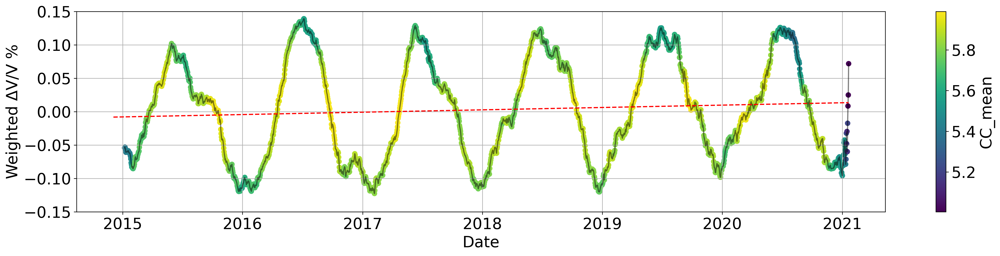

In [58]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_0p1to0p3 positiveZN 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeZN 6010svd7x.csv',
    'B1_60daystack_0p1to0p3 positiveNE 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeNE 6010svd7x.csv',
    'B1_60daystack_0p1to0p3 positiveZE 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeZE 6010svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, -1, -1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2023-10-01")
end_date = pd.to_datetime("2024-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2010-01-10")
end_date = pd.to_datetime("2011-02-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(20, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.15,0.15])
plt.ylabel('Weighted ΔV/V %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
start_date = pd.to_datetime("2010-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 20})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

In [59]:
weighted_dvv_df

,Weighted Δv/v
2014-12-04,NaN
2014-12-05,NaN
2014-12-06,NaN
2014-12-07,NaN
2014-12-08,NaN
...,...
2021-01-16,-0.059819
2021-01-17,-0.017301
2021-01-18,0.008484
2021-01-19,0.025021


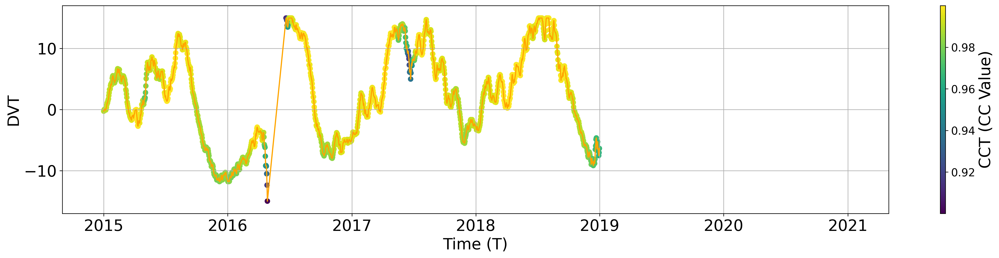

In [76]:
import pandas as pd
import matplotlib.pyplot as plt
import os
import matplotlib as mpl

# Define the single file path
file_path = 'synthetic_n.csv'

# Define the inversion switch for the single file
inversion = 1  # Set to 1 or -1 based on your requirement


# Define the date range (optional, uncomment if needed)
start_date = pd.to_datetime("2014-09-01")
end_date = pd.to_datetime("2021-05-01")
mpl.rcParams.update({'font.size': 20})

# Create a single subplot
fig, ax = plt.subplots(figsize=(20, 5), dpi=300)  # Adjust figsize as needed

# Load the data
data = pd.read_csv(file_path)

# Convert the 'T' column to datetime format if necessary
data['T'] = pd.to_datetime(data['T'])

# Apply inversion
data['DVT'] *= inversion

# Plot scatter and line
scatter = ax.scatter(data['T'], data['DVT'], c=data['CCT'], cmap='viridis', label='Scatter')
ax.plot(data['T'], data['DVT'], label='Line', color='orange')  # You can choose a different color if desired

# Set title and labels
ax.set_xlabel('Time (T)')
ax.set_ylabel('DVT')
ax.tick_params(axis='both', which='major')

# Set axis limits (optional)
# ax.set_xlim([start_date, end_date])  # Uncomment if you want to set x-axis limits
ax.set_ylim([-17, 17])  # Adjust y-axis limits as needed
plt.xlim([start_date, end_date])
# Add a color bar
cbar = fig.colorbar(scatter, ax=ax, orientation='vertical', label='CC', aspect=40)
cbar.ax.tick_params(labelsize=14)  # Adjust color bar tick label size if needed

# Improve layout
plt.tight_layout()

plt.grid(True)

# Show the plot
plt.show()


In [15]:
# Assuming weighted_dvv_df is already defined and has a DatetimeIndex
index = weighted_dvv_df.index

# Calculate the time differences between consecutive dates
time_diffs = np.diff(index).astype('timedelta64[D]')

# Calculate the mean time difference in days
mean_time_diff = np.mean(time_diffs).astype('timedelta64[D]').astype(float)

# Calculate the sampling rate as the reciprocal of the mean time difference
samplingrate = 1 / mean_time_diff

print(f"Sampling rate: {sampling_rate} samples per day")

Sampling rate: 1.0 samples per day


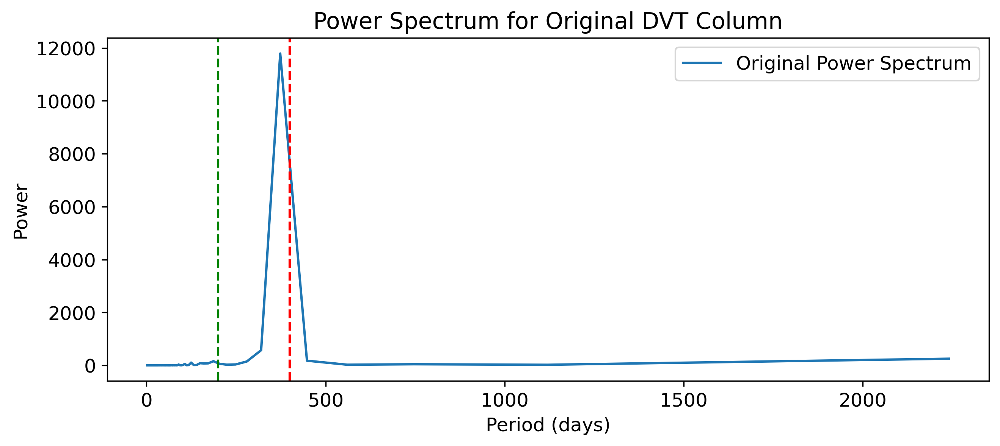

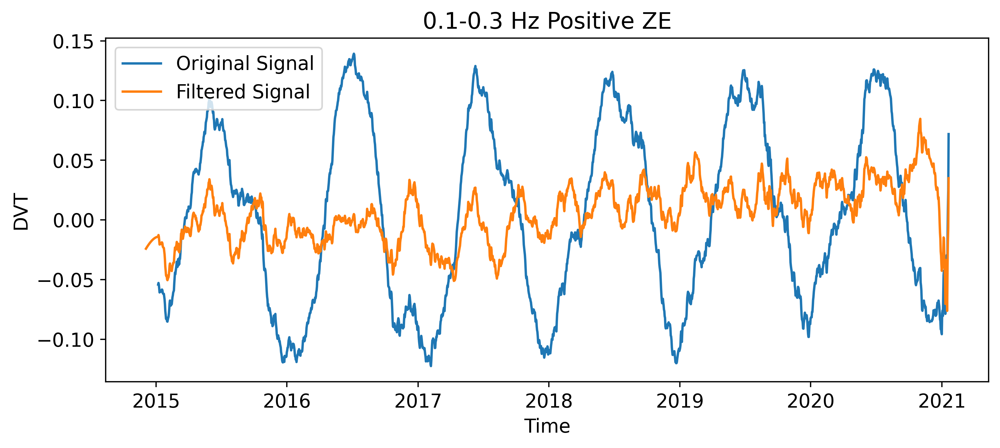

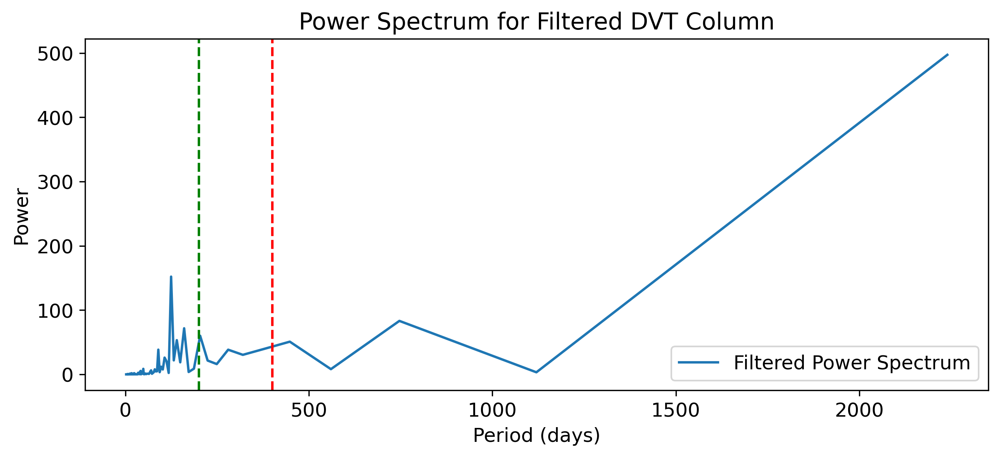

In [122]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq
from scipy.signal import butter, filtfilt

# Assuming weighted_dvv_df is already defined
# weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

# Extract the 'Weighted Δv/v' column into a separate variable
dvt_values = weighted_dvv_df['Weighted Δv/v'].values

# Interpolate or fill NaNs in the signal
dvt_values_filled = pd.Series(dvt_values).interpolate().fillna(method='bfill').fillna(method='ffill').values

# Define the sample rate
samplingrate = 1  # Sample rate is 1 sample per day
fs = 1 / samplingrate

# Define the stop band
lowcut = 1 / 400  # 1/500 days
highcut = 1 / 200  # 1/180 days

# Design the band-stop filter
nyquist = 0.5 * fs
low = lowcut / nyquist
high = highcut / nyquist
b, a = butter(4, [low, high], btype='bandstop')

# Apply the band-stop filter to the signal
filtered_dvt_values = filtfilt(b, a, dvt_values_filled)

# Perform FFT on the original signal
n = len(dvt_values_filled)
dvt_fft = fft(dvt_values_filled)
frequencies = fftfreq(n, d=1/fs)
power_spectrum = np.abs(dvt_fft)**2

# Perform FFT on the filtered signal
filtered_dvt_fft = fft(filtered_dvt_values)
filtered_power_spectrum = np.abs(filtered_dvt_fft)**2

# Get the positive frequencies and power spectrum
positive_frequencies = frequencies[frequencies > 0]
positive_power_spectrum = power_spectrum[frequencies > 0]
filtered_positive_power_spectrum = filtered_power_spectrum[frequencies > 0]
plt.rcParams.update({'font.size': 12})
# Plot the power spectrum of the original signal
plt.figure(figsize=(10, 4), dpi=300)
plt.plot(1/positive_frequencies, positive_power_spectrum, label='Original Power Spectrum')
plt.axvline(x=1/lowcut, color='r', linestyle='--')
plt.axvline(x=1/highcut, color='g', linestyle='--')
plt.xlabel('Period (days)')
plt.ylabel('Power')
plt.title('Power Spectrum for Original DVT Column')
plt.legend()
plt.show()

# Plot the original and filtered signals
plt.figure(figsize=(10, 4), dpi=400)
plt.plot(weighted_dvv_df.index, dvt_values, label='Original Signal')
plt.plot(weighted_dvv_df.index, filtered_dvt_values, label='Filtered Signal')
plt.xlabel('Time')
plt.ylabel('DVT')
plt.title('0.1-0.3 Hz Positive ZE')
plt.legend()
plt.show()

# Plot the power spectrum of the filtered signal
plt.figure(figsize=(10, 4), dpi=300)
plt.plot(1/positive_frequencies, filtered_positive_power_spectrum, label='Filtered Power Spectrum')
plt.axvline(x=1/lowcut, color='r', linestyle='--')
plt.axvline(x=1/highcut, color='g', linestyle='--')
plt.xlabel('Period (days)')
plt.ylabel('Power')
plt.title('Power Spectrum for Filtered DVT Column')
plt.legend()
plt.show()


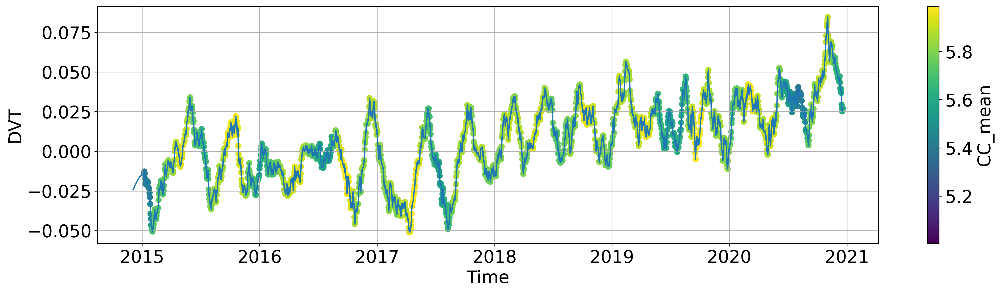

In [124]:
# Create a boolean mask to filter data before December 20th, 2020
mask = weighted_dvv_df.index < pd.to_datetime('2020-12-20')

# Filter the DataFrame and the corresponding DVT values using the same mask
filtered_dvv_df = weighted_dvv_df[mask]
filtered_dvt_values = filtered_dvt_values[mask]

# Plot
plt.figure(figsize=(20, 5), dpi=300)
# Scatter plot for individual markers with color coding
plt.rcParams.update({'font.size': 20})
sc = plt.scatter(filtered_dvv_df.index, filtered_dvt_values, c=CC_mean[mask], cmap=cmap, norm=norm)

plt.plot(filtered_dvv_df.index, filtered_dvt_values, label='Filtered Signal')
plt.colorbar(sc, label='CC_mean')
plt.xlabel('Time')
plt.ylabel('DVT')
#plt.title('0.1-0.3 Hz Positive ZE (Data before December 20th, 2020)')
plt.grid(True)
plt.show()


In [104]:
weighted_dvv_df

,Weighted Δv/v
2014-12-04,NaN
2014-12-05,NaN
2014-12-06,NaN
2014-12-07,NaN
2014-12-08,NaN
...,...
2021-01-16,-0.059819
2021-01-17,-0.017301
2021-01-18,0.008484
2021-01-19,0.025021


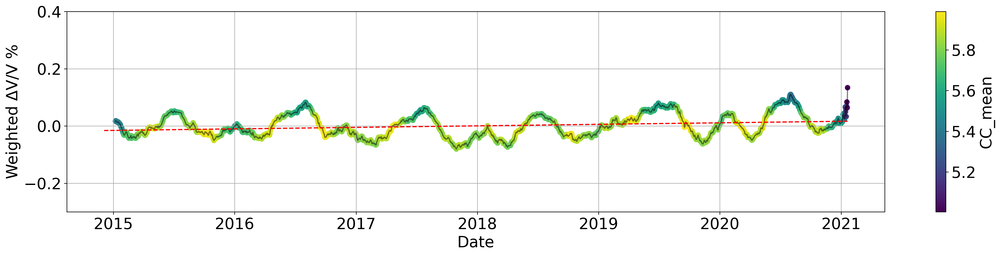

In [7]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_0p1to0p3 positiveZN 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeZN 6010svd7x.csv',
    'B1_60daystack_0p1to0p3 positiveNE 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeNE 6010svd7x.csv',
    'B1_60daystack_0p1to0p3 positiveZE 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeZE 6010svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2023-10-01")
end_date = pd.to_datetime("2024-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2010-01-10")
end_date = pd.to_datetime("2011-02-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(20, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.3,0.4])
plt.ylabel('Weighted ΔV/V %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
start_date = pd.to_datetime("2010-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 20})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

In [208]:
weighted_dvv_df.index

DatetimeIndex(['2014-12-17', '2014-12-18', '2014-12-19', '2014-12-20',
               '2014-12-21', '2014-12-22', '2014-12-23', '2014-12-24',
               '2014-12-25', '2014-12-26',
               ...
               '2020-07-23', '2020-07-24', '2020-07-25', '2020-07-26',
               '2020-07-27', '2020-07-28', '2020-07-29', '2020-07-30',
               '2020-07-31', '2020-08-01'],
              dtype='datetime64[ns]', length=2055, freq=None)

In [4]:
# Define the date range to exclude
start_date = pd.to_datetime("2017-03-25")
end_date = pd.to_datetime("2017-06-02")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-10-30")
end_date = pd.to_datetime("2016-12-03")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

2060

In [ ]:
# Define the date range to exclude
start_date = pd.to_datetime("2010-01-01")
end_date = pd.to_datetime("2014-12-01")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-10-31")
end_date = pd.to_datetime("2016-10-02")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    


In [ ]:
# Define the date range to exclude
start_date = pd.to_datetime("2010-01-01")
end_date = pd.to_datetime("2014-12-01")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-09-29")
end_date = pd.to_datetime("2016-11-20")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    

In [ ]:
# Define the date range to exclude
start_date = pd.to_datetime("2010-01-01")
end_date = pd.to_datetime("2014-12-01")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-10-15")
end_date = pd.to_datetime("2016-12-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2017-04-10")
end_date = pd.to_datetime("2017-06-03")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    


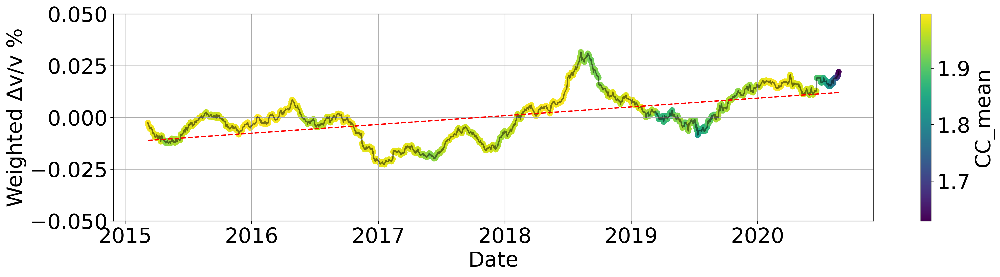

In [362]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    '/home/seismic/AmbientNoiseOOI/src/HYS14B1 Results/14B1_60daystack_0p5to1p0 negativeZZ 8070svd7x.csv',
    '/home/seismic/AmbientNoiseOOI/src/HYS14B1 Results/14B1_60daystack_0p5to1p0 positiveZZ 7080svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-08-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2010-01-10")
end_date = pd.to_datetime("2015-02-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(18, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.05,0.05])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
start_date = pd.to_datetime("2010-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

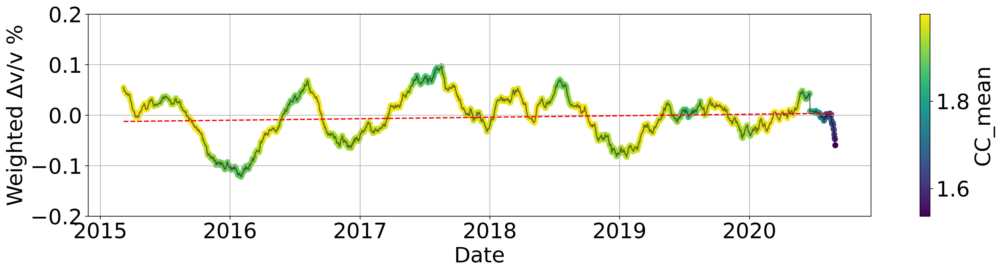

In [359]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    '/home/seismic/AmbientNoiseOOI/src/HYS14B1 Results/14B1_60daystack_0p1to0p3 negativeZZ 9050svd7x.csv',
    '/home/seismic/AmbientNoiseOOI/src/HYS14B1 Results/14B1_60daystack_0p1to0p3 positiveZZ 5090svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-08-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2010-01-10")
end_date = pd.to_datetime("2015-02-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(18, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.2,0.2])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
start_date = pd.to_datetime("2010-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

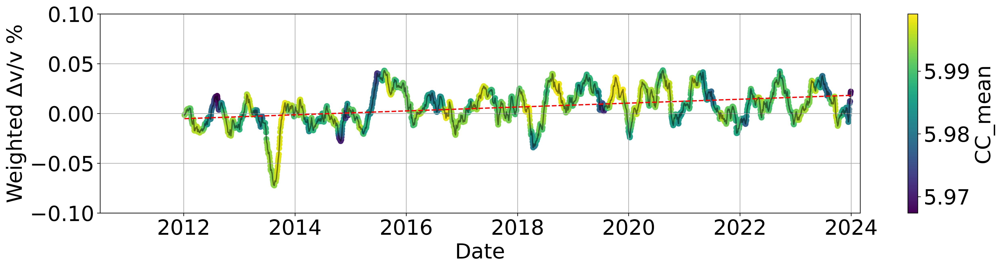

In [347]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p5to1p0 positiveNZ 1025svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p5to1p0 negativeNZ 2510svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p5to1p0 positiveNE 1025svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p5to1p0 negativeNE 2510svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p5to1p0 positiveZE 1025svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p5to1p0 negativeZE 2510svd7.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,-1, 1, 1, 1, -1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2023-12-01")
end_date = pd.to_datetime("2024-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2010-01-10")
end_date = pd.to_datetime("2011-12-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(18, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.1,0.1])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
start_date = pd.to_datetime("2010-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

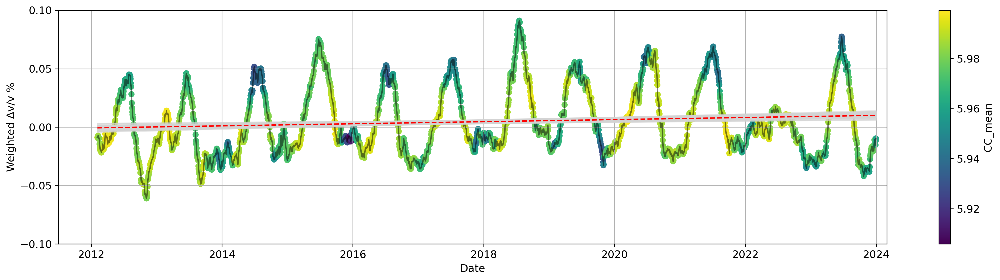

In [176]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p3to0p6 positiveZN 630svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p3to0p6 negativeZN 306svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p3to0p6 positiveNE 630svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p3to0p6 negativeNE 306svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p3to0p6 positiveZE 630svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p3to0p6 negativeZE 306svd7.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,-1, -1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2023-12-01")
end_date = pd.to_datetime("2024-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2009-11-10")
end_date = pd.to_datetime("2012-01-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(18, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.1,0.1])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)
index_values, mean_trend_values,bootstrap_trend_lines = calculate_bootstrap_mean_trend(cleaned_df)
# Perform the polynomial fit
#z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
#p = np.poly1d(z)
for i in range(bootstrap_trend_lines.shape[0]):
    plt.plot(index_values, bootstrap_trend_lines[i], color='lightgrey', alpha=0.5)
plt.plot(index_values, mean_trend_values, "r--", label='Trend Line')
start_date = pd.to_datetime("2011-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

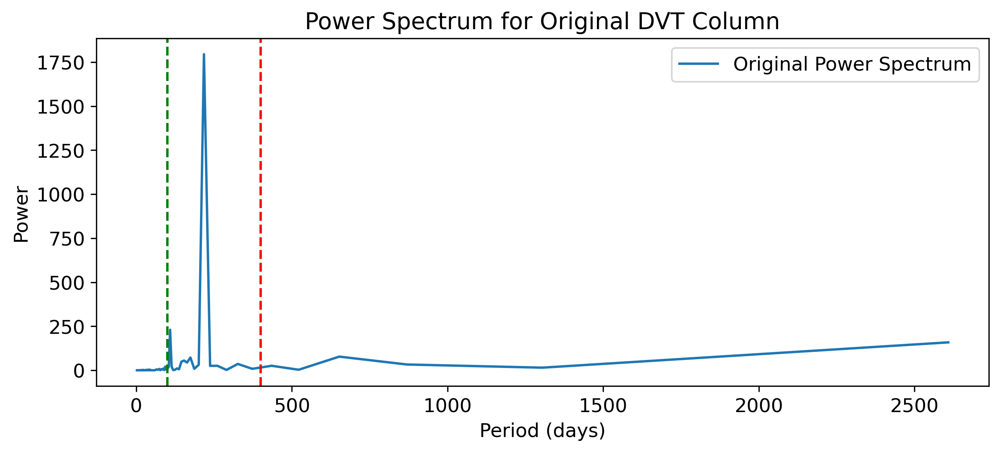

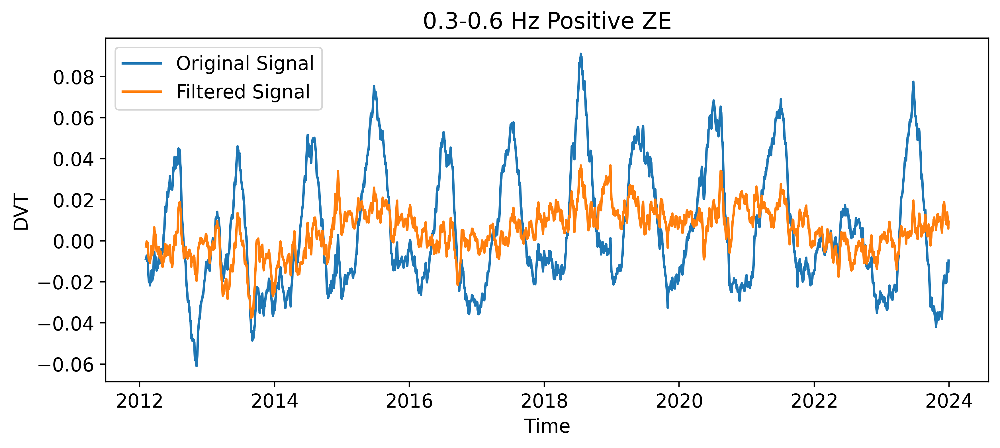

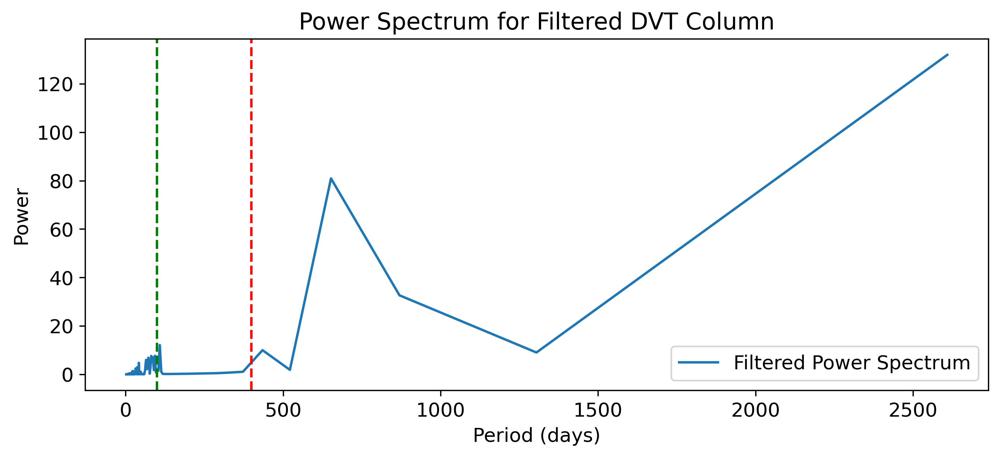

In [182]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq
from scipy.signal import butter, filtfilt

# Assuming weighted_dvv_df is already defined
# weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

# Extract the 'Weighted Δv/v' column into a separate variable
dvt_values = weighted_dvv_df['Weighted Δv/v'].values

# Interpolate or fill NaNs in the signal
dvt_values_filled = pd.Series(dvt_values).interpolate().fillna(method='bfill').fillna(method='ffill').values

# Define the sample rate
samplingrate = 1  # Sample rate is 1 sample per day
fs = 1 / samplingrate

# Define the stop band
lowcut = 1 / 400  # 1/500 days
highcut = 1 / 100  # 1/180 days

# Design the band-stop filter
nyquist = 0.5 * fs
low = lowcut / nyquist
high = highcut / nyquist
b, a = butter(4, [low, high], btype='bandstop')

# Apply the band-stop filter to the signal
filtered_dvt_values = filtfilt(b, a, dvt_values_filled)

# Perform FFT on the original signal
n = len(dvt_values_filled)
dvt_fft = fft(dvt_values_filled)
frequencies = fftfreq(n, d=1/fs)
power_spectrum = np.abs(dvt_fft)**2

# Perform FFT on the filtered signal
filtered_dvt_fft = fft(filtered_dvt_values)
filtered_power_spectrum = np.abs(filtered_dvt_fft)**2

# Get the positive frequencies and power spectrum
positive_frequencies = frequencies[frequencies > 0]
positive_power_spectrum = power_spectrum[frequencies > 0]
filtered_positive_power_spectrum = filtered_power_spectrum[frequencies > 0]
plt.rcParams.update({'font.size': 12})
# Plot the power spectrum of the original signal
plt.figure(figsize=(10, 4), dpi=300)
plt.plot(1/positive_frequencies, positive_power_spectrum, label='Original Power Spectrum')
plt.axvline(x=1/lowcut, color='r', linestyle='--')
plt.axvline(x=1/highcut, color='g', linestyle='--')
plt.xlabel('Period (days)')
plt.ylabel('Power')
plt.title('Power Spectrum for Original DVT Column')
plt.legend()
plt.show()

# Plot the original and filtered signals
plt.figure(figsize=(10, 4), dpi=400)
plt.plot(weighted_dvv_df.index, dvt_values, label='Original Signal')
plt.plot(weighted_dvv_df.index, filtered_dvt_values, label='Filtered Signal')
plt.xlabel('Time')
plt.ylabel('DVT')
plt.title('0.3-0.6 Hz Positive ZE')
plt.legend()
plt.show()

# Plot the power spectrum of the filtered signal
plt.figure(figsize=(10, 4), dpi=300)
plt.plot(1/positive_frequencies, filtered_positive_power_spectrum, label='Filtered Power Spectrum')
plt.axvline(x=1/lowcut, color='r', linestyle='--')
plt.axvline(x=1/highcut, color='g', linestyle='--')
plt.xlabel('Period (days)')
plt.ylabel('Power')
plt.title('Power Spectrum for Filtered DVT Column')
plt.legend()
plt.show()


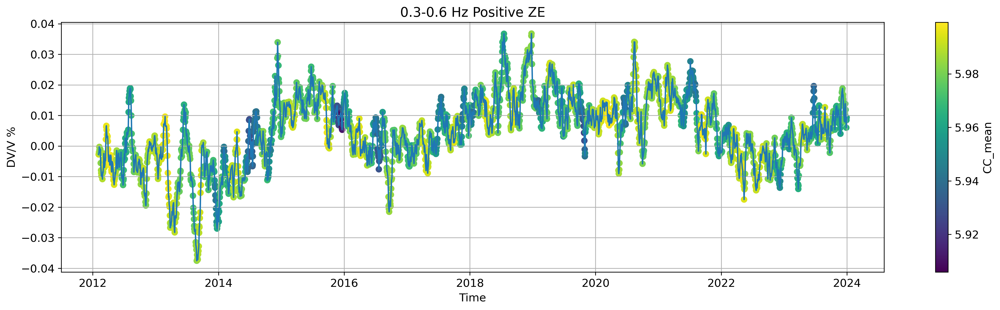

In [183]:
plt.figure(figsize=(20, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, filtered_dvt_values, c=CC_mean, cmap=cmap, norm=norm)

plt.plot(weighted_dvv_df.index, filtered_dvt_values, label='Filtered Signal')
plt.colorbar(sc, label='CC_mean')
plt.xlabel('Time')
plt.ylabel('DV/V %')
plt.title('0.3-0.6 Hz Positive ZE')
plt.rcParams.update({'font.size': 25})
plt.grid(True)
plt.show()

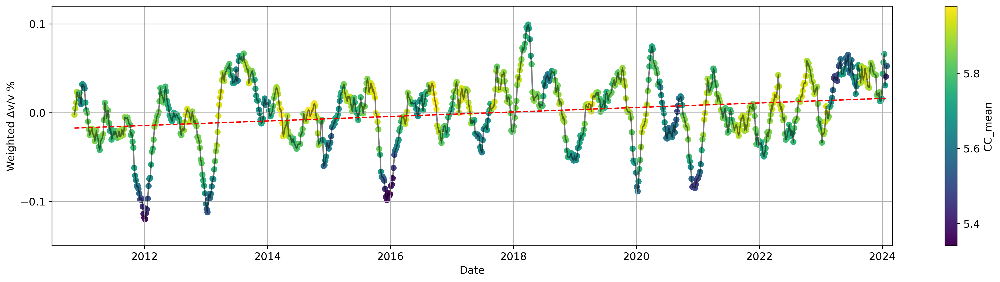

In [172]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p1to0p3 positiveZN 1060svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p1to0p3 negativeZN 6010svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p1to0p3 positiveNE 1060svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p1to0p3 negativeNE 6010svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p1to0p3 positiveZE 1060svd7.csv',
    '/home/seismic/AmbientNoiseOOI/src/NC89 Results/89_60daystack_0p1to0p3 negativeZE 6010svd7.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [-1,1, 1, -1, -1, 1]
multipliers = [1,1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-12-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
#for i in range(len(interpolated_dfs)):
#    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-11-10")
end_date = pd.to_datetime("2017-01-05")

# Exclude the specified date range
#for i in range(len(interpolated_dfs)):
#    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(18, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.15,0.12])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
start_date = pd.to_datetime("2010-07-01")
end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

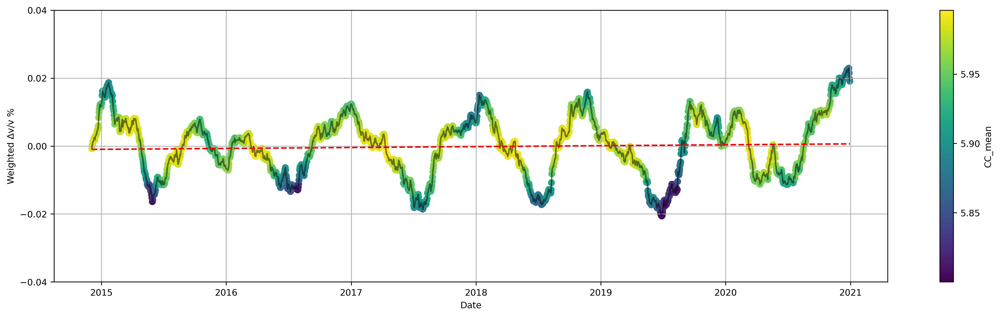

In [51]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_0p3to0p6 positiveZN 1560svd7x.csv',
    'B1_60daystack_0p3to0p6 negativeZN 6015svd7x.csv',
    'B1_60daystack_0p3to0p6 positiveNE 1560svd7x.csv',
    'B1_60daystack_0p3to0p6 negativeNE 6015svd7x.csv',
    'B1_60daystack_0p3to0p6 positiveZE 1560svd7x.csv',
    'B1_60daystack_0p3to0p6 negativeZE 6015svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [-1,1, -1, -1, 1, 1]
multipliers = [1,1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-12-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-11-10")
end_date = pd.to_datetime("2017-01-05")

# Exclude the specified date range
#for i in range(len(interpolated_dfs)):
#    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(16, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.04,0.04])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
#start_date = pd.to_datetime("2010-07-01")
#end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

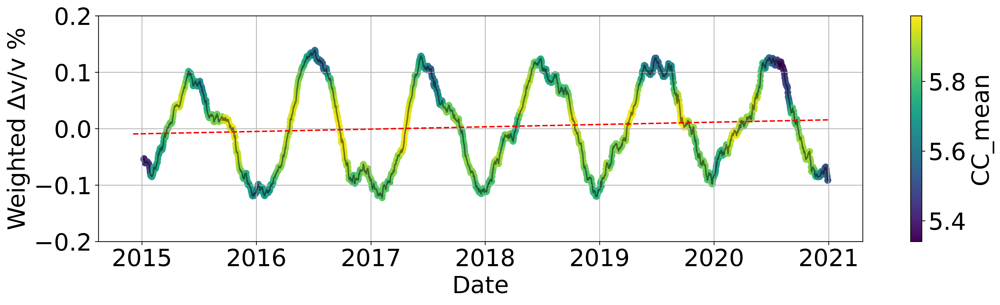

In [292]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_0p1to0p3 positiveZN 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeZN 6010svd7x.csv',
    'B1_60daystack_0p1to0p3 positiveNE 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeNE 6010svd7x.csv',
    'B1_60daystack_0p1to0p3 positiveZE 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeZE 6010svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, -1, -1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-12-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-11-10")
end_date = pd.to_datetime("2017-01-05")

# Exclude the specified date range
#for i in range(len(interpolated_dfs)):
#    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(16, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.2,0.2])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
#start_date = pd.to_datetime("2010-07-01")
#end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

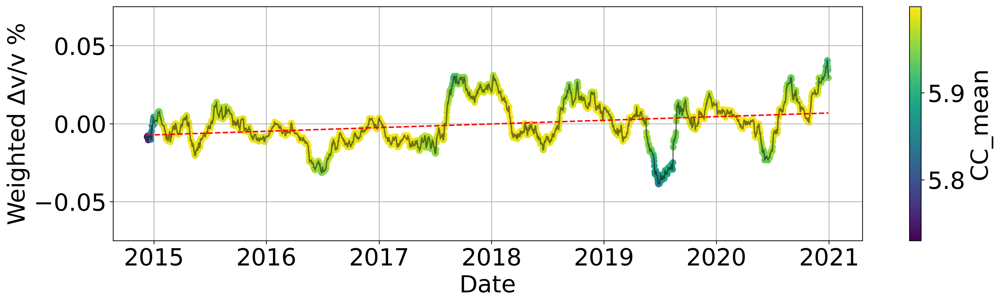

In [376]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_1p0to3p0 positiveZN 515svd7x.csv',
    'B1_60daystack_1p0to3p0 negativeZN 155svd7x.csv',
    'B1_60daystack_1p0to3p0 positiveNE 515svd7x.csv',
    'B1_60daystack_1p0to3p0 negativeNE 155svd7x.csv',
    'B1_60daystack_1p0to3p0 positiveZE 515svd7x.csv',
    'B1_60daystack_1p0to3p0 negativeZE 155svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-12-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-11-10")
end_date = pd.to_datetime("2017-01-05")

# Exclude the specified date range
#for i in range(len(interpolated_dfs)):
#    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(16, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line
z = np.polyfit(weighted_dvv_df.index.astype(np.int64), weighted_dvv_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
#plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.075,0.075])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

index_values, mean_trend_values = calculate_bootstrap_mean_trend(cleaned_df)
# Perform the polynomial fit
#z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
#p = np.poly1d(z)

plt.plot(index_values, mean_trend_values, "r--", label='Trend Line')
#start_date = pd.to_datetime("2010-07-01")
#end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

## Weighted Δv/v For HYS14 0.3-0.6Hz Combined

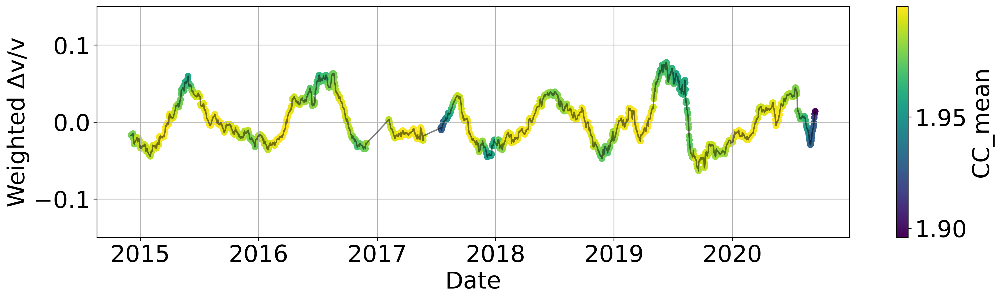

In [265]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    '14_60daystack_0p3to0p6 positiveZE 1530svd7x.csv',
    '14_60daystack_0p3to0p6 negativeZE 3015svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,-1, -1, 1, -1, -1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2017-04-25")
end_date = pd.to_datetime("2017-06-15")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-11-01")
end_date = pd.to_datetime("2017-01-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(16, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line
z = np.polyfit(weighted_dvv_df.index.astype(np.int64), weighted_dvv_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
#plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
#plt.title('Weighted Δv/v For HYS14 0.3-0.6Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.15,0.15])
plt.ylabel('Weighted Δv/v')
plt.grid(True)
plt.rcParams.update({'font.size': 15})  # Increase font size
#start_date = pd.to_datetime("2010-07-01")
#end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

## Weighted Δv/v For HYS14 0.1-0.3Hz Combined

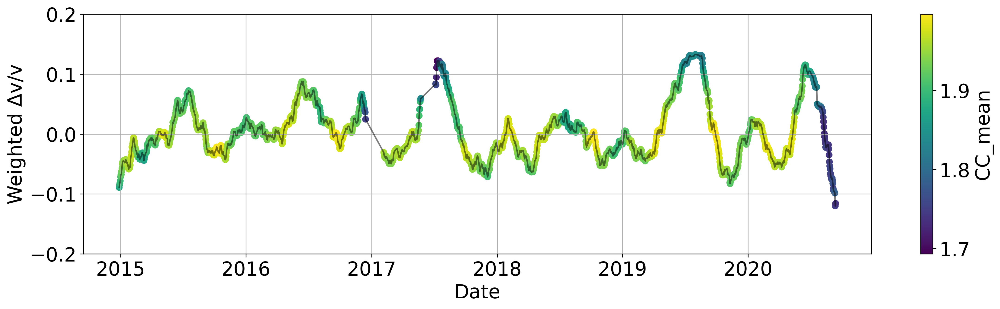

In [8]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    '14_60daystack_0p1to0p3 positiveZE 2070svd7x.csv',
    '14_60daystack_0p1to0p3 negativeZE 7020svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, -1, 1, -1, -1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2017-04-25")
end_date = pd.to_datetime("2017-06-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-12-01")
end_date = pd.to_datetime("2017-01-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(16, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line
z = np.polyfit(weighted_dvv_df.index.astype(np.int64), weighted_dvv_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
#plt.title('Weighted Δv/v For HYS14 0.1-0.3Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.2,0.2])
plt.ylabel('Weighted Δv/v')
plt.grid(True)
plt.rcParams.update({'font.size': 15})  # Increase font size
#start_date = pd.to_datetime("2010-07-01")
#end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

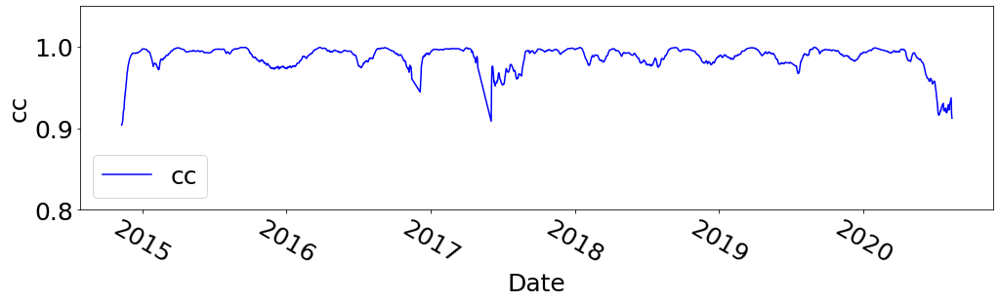

In [31]:
plt.figure(figsize=(15, 5))
plt.plot(df.index, df['CCT'], label="cc", color='blue')
plt.ylim(0.8, 1.05)
plt.xlabel('Date')
plt.ylabel('cc')

plt.xticks(rotation=-30)
plt.legend()
plt.tight_layout()
plt.show()

## Weighted Δv/v For HYS14 0.5-1.0Hz Combined

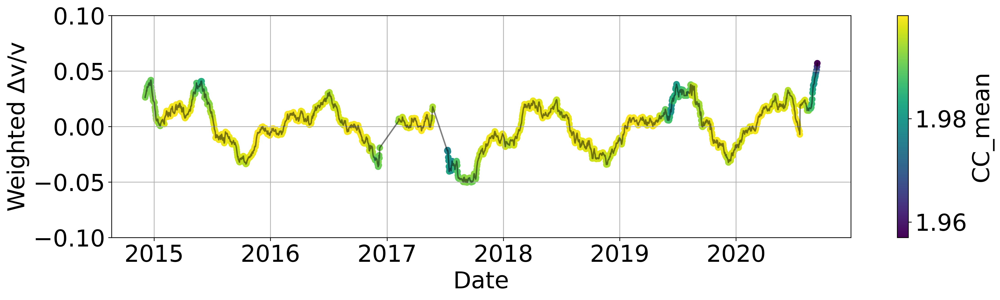

In [263]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    '14_60daystack_0p5to1p0 positiveZE 515svd7x.csv',
    '14_60daystack_0p5to1p0 negativeZE 155svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [-1,-1, -1, 1, -1, -1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2017-04-25")
end_date = pd.to_datetime("2017-06-08")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-11-10")
end_date = pd.to_datetime("2017-01-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(16, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line
z = np.polyfit(weighted_dvv_df.index.astype(np.int64), weighted_dvv_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
#plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
#plt.title('Weighted Δv/v For HYS14 0.5-1.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.1,0.1])
plt.ylabel('Weighted Δv/v')
plt.grid(True)
plt.rcParams.update({'font.size': 15})  # Increase font size
#start_date = pd.to_datetime("2010-07-01")
#end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

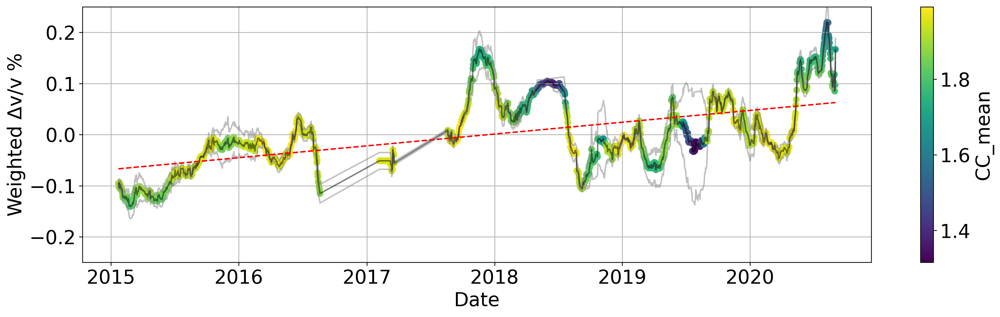

In [339]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYS14_35ZEp1.csv',
    'HYS14_35ZEn1.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date ranges to exclude
exclude_ranges = [
    ("2017-03-01", "2017-07-30"),
    ("2016-08-01", "2017-01-16"),
]

# Exclude the specified date ranges
for start_date, end_date in exclude_ranges:
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=20)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=20)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
plt.ylim([-0.25, 0.25])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


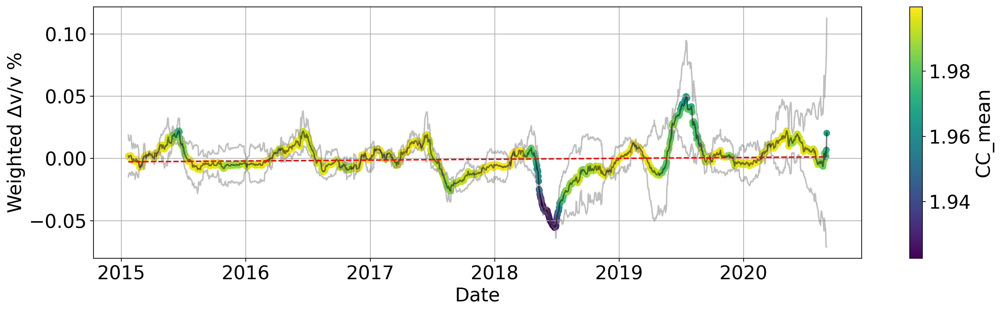

In [306]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYS12_13ZEp1.csv',
    'HYS12_13ZEn1.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [-1, 1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=20)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=20)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
#plt.ylim([-0.25, 0.25])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


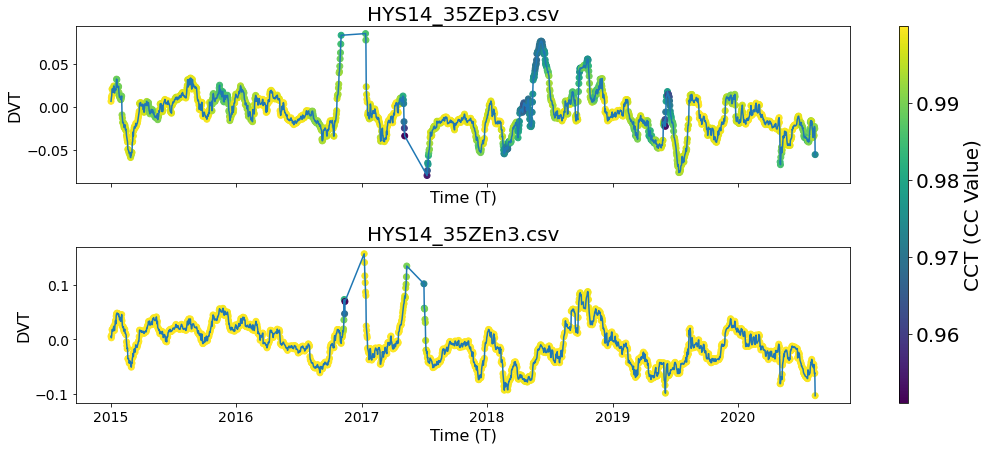

In [309]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# List of all file paths
file_paths = ['HYS14_35ZEp3.csv', 'HYS14_35ZEn3.csv']

# Predefined array of inversion switches
inversion_array = [1,-1, 1, -1, 1]

start_date = pd.to_datetime("2015-01-01")
end_date = pd.to_datetime("2021-01-01")

# Create a figure with 6 subplots (3 rows and 2 columns)
fig, axs = plt.subplots(len(file_paths), 1, figsize=(15, len(file_paths)*3.33), sharex=True, sharey=False)

# Flatten the array of axes for easier iteration
axs = axs.flatten()

for idx, file_path in enumerate(file_paths):
    # Load the data
    data = pd.read_csv(file_path)
    
    # Convert the 'T' column to datetime format if necessary
    data['T'] = pd.to_datetime(data['T'])
    
    # Apply inversion based on the predefined array
    data['DVT'] *= inversion_array[idx]
    
    # Plotting scatter and line on the corresponding subplot
    scatter = axs[idx].scatter(data['T'], data['DVT'], c=data['CCT'], cmap='viridis', label='Scatter')
    axs[idx].plot(data['T'], data['DVT'], label='Line')
    
    # Set title and labels for each subplot
    axs[idx].set_title(os.path.basename(file_path), fontsize=20)
    axs[idx].set_xlabel('Time (T)', fontsize=16)
    axs[idx].set_ylabel('DVT', fontsize=16)
    axs[idx].tick_params(axis='both', which='major', labelsize=14)
    #axs[idx].set_xlim([start_date, end_date])  # Set x-axis limits
    #axs[idx].set_ylim([-0.3, 0.3])  # Set x-axis limits

# Adjust subplot layout
plt.tight_layout()
#plt.ylim([-1.0,1.0])

# Add a color bar in the figure
fig.colorbar(scatter, ax=axs, orientation='vertical', label='CCT (CC Value)', aspect=40)

# Show the plot
plt.show()


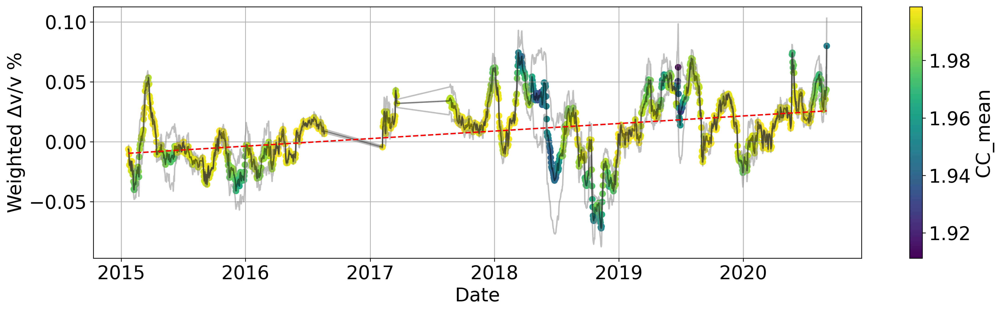

In [320]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = ['HYS14_35ZEp3.csv', 'HYS14_35ZEn3.csv']

# Predefined array with multipliers (-1 or +1)
multipliers = [-1, 1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date ranges to exclude
exclude_ranges = [
    ("2017-03-01", "2017-07-30"),
    ("2016-08-01", "2017-01-16"),
]

# Exclude the specified date ranges
for start_date, end_date in exclude_ranges:
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=20)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=20)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
#plt.ylim([-0.25, 0.25])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


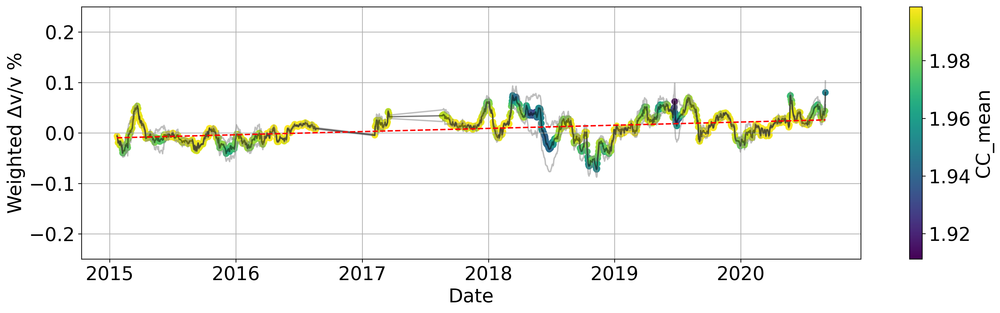

In [352]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYS14_35ZEp3.csv',
    'HYS14_35ZEn3.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [-1, 1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date ranges to exclude
exclude_ranges = [
    ("2017-03-01", "2017-07-30"),
    ("2016-08-01", "2017-01-16"),
]

# Exclude the specified date ranges
for start_date, end_date in exclude_ranges:
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=20)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=20)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
plt.ylim([-0.25, 0.25])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


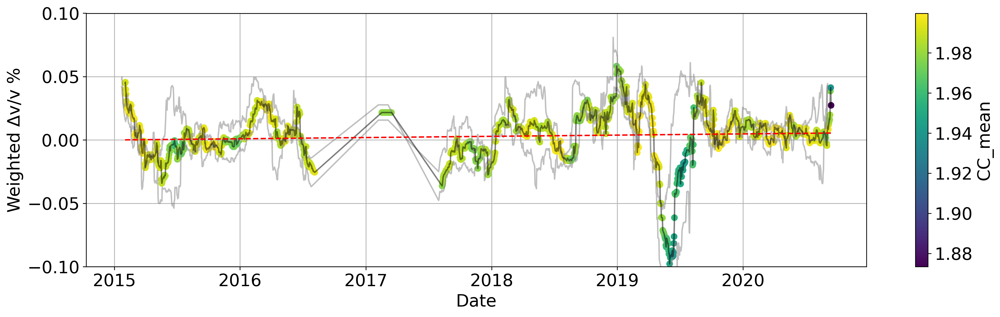

In [133]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYS14_13ZEp.csv',
    'HYS14_13ZEn.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date ranges to exclude
exclude_ranges = [
    ("2017-02-15", "2017-07-10"),
    ("2016-07-07", "2017-01-16"),
]

# Exclude the specified date ranges
for start_date, end_date in exclude_ranges:
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=20)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
plt.ylim([-0.1, 0.1])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


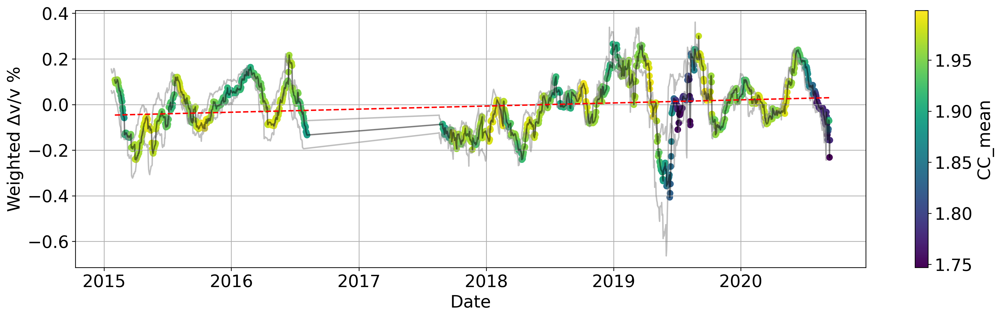

In [198]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYS14_0103ZEp.csv',
    'HYS14_0103ZEn.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [-1, 1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date ranges to exclude
exclude_ranges = [
    ("2017-02-15", "2017-07-28"),
    ("2016-07-07", "2017-02-17"),
]

# Exclude the specified date ranges
for start_date, end_date in exclude_ranges:
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=20)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
#plt.ylim([-0.15, 0.15])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


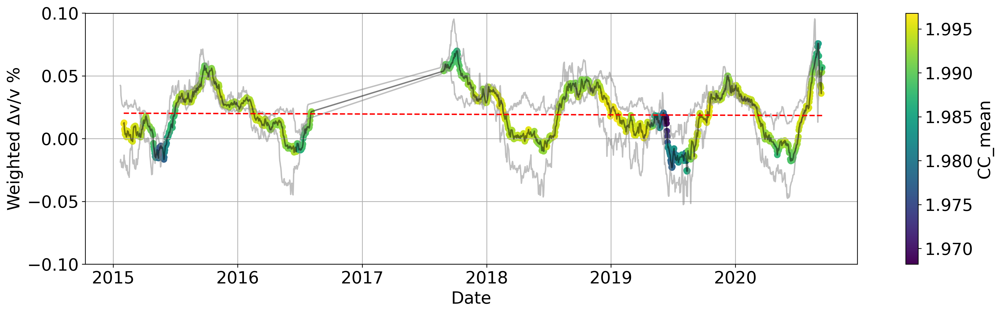

In [201]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYS14_051ZEp.csv',
    'HYS14_051ZEn.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
        # Adjust DVT column values
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date ranges to exclude
exclude_ranges = [
    ("2017-02-15", "2017-07-28"),
    ("2016-07-07", "2017-02-17"),
]

# Exclude the specified date ranges
for start_date, end_date in exclude_ranges:
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=20)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
plt.ylim([-0.1, 0.1])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


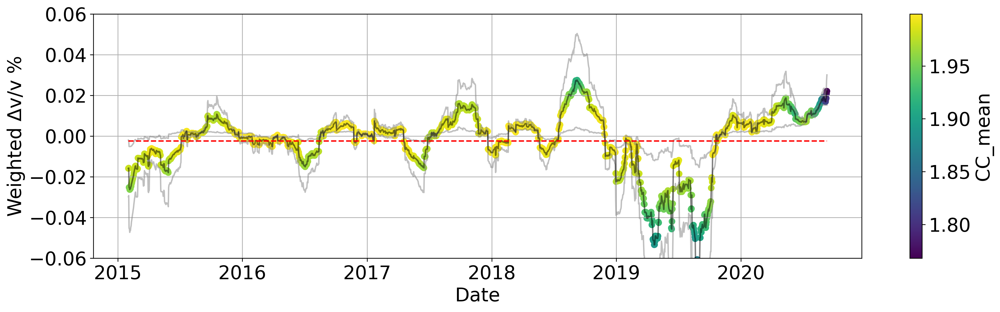

In [228]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYS14B1_052ZZp.csv',
    'HYS14B1_052ZZn.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
        # Adjust DVT column values
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]


# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=30)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
plt.ylim([-0.06, 0.06])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


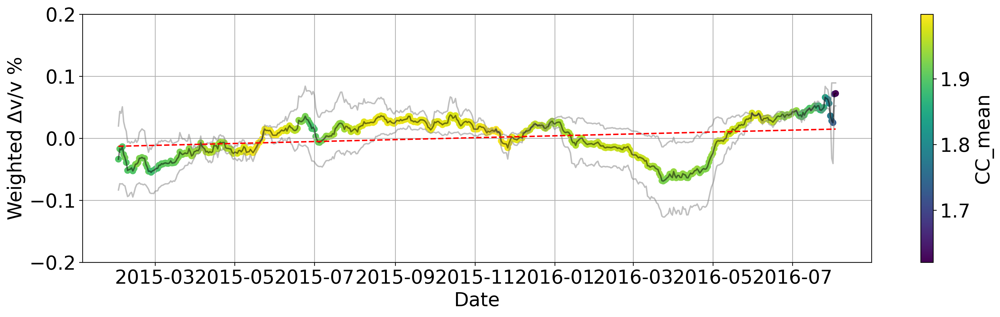

In [363]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYSB1_2015ZEp.csv',
    'HYSB1_2015ZEn.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, -1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
        # Adjust DVT column values
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]


# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=30)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
plt.ylim([-0.2, 0.2])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


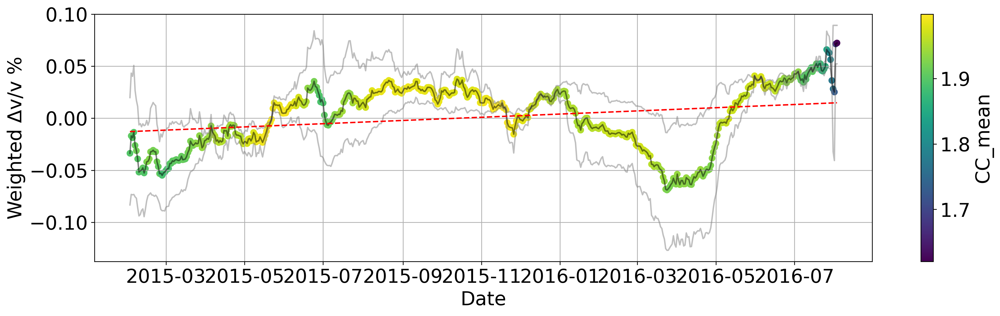

In [364]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYSB1_2015ZEp.csv',
    'HYSB1_2015ZEn.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, -1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date ranges to exclude
exclude_ranges = [
    ("2017-02-15", "2017-07-28"),
    ("2016-07-07", "2017-02-17"),
]

# Exclude the specified date ranges
for start_date, end_date in exclude_ranges:
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=30)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
#plt.ylim([-0.15, 0.15])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


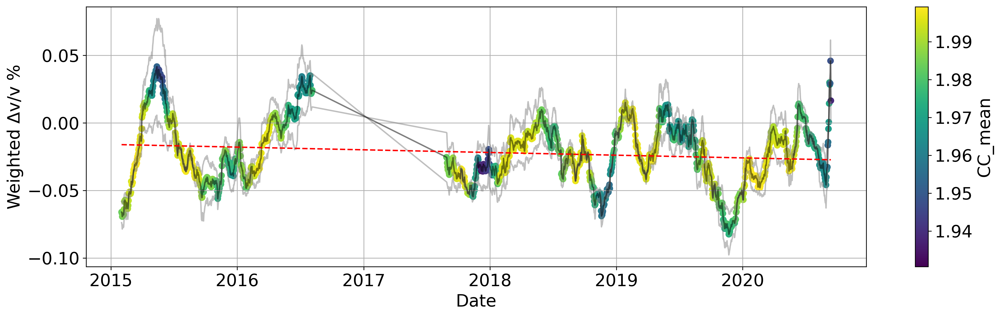

In [200]:
# import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'HYS14_0306ZEp.csv',
    'HYS14_0306ZEn.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, -1]

# Read and process dataframes
dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    dataframes.append(df)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date ranges to exclude
exclude_ranges = [
    ("2017-02-15", "2017-07-28"),
    ("2016-07-07", "2017-02-17"),
]

# Exclude the specified date ranges
for start_date, end_date in exclude_ranges:
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Shift the grey individual timeseries by 20 days and plot them
plt.figure(figsize=(16, 5), dpi=300)
for df in interpolated_dfs:
    shifted_df = df.copy()
    shifted_df.index = shifted_df.index + pd.DateOffset(days=30)
    plt.plot(shifted_df.index, shifted_df['DVT'], color='grey', alpha=0.5)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')

# Adding a trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')

# Add labels and legend
plt.xlabel('Date')
#plt.ylim([-0.15, 0.15])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)
plt.tight_layout()
plt.show()


Index(['Date', 'PGV'], dtype='object')


NameError: name 'calculate_bootstrap_mean_trend' is not defined

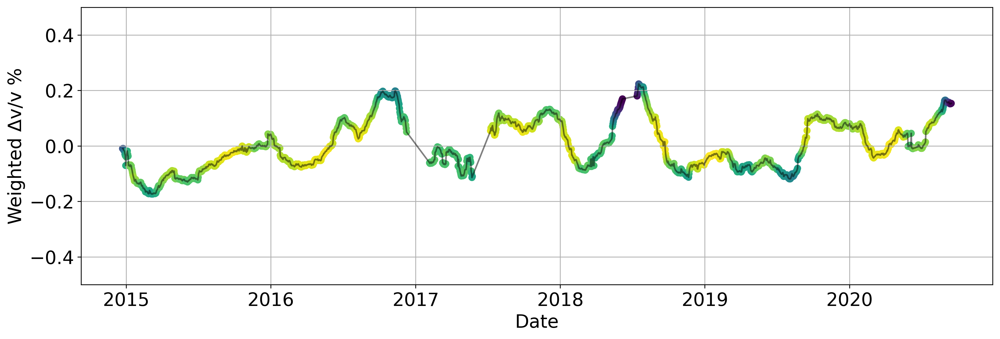

In [97]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    '14_60daystack_3p0to6p0 positiveZE 210svd7x.csv',
    '14_60daystack_3p0to6p0 negativeZE 102svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
exclude_ranges = [
    ("2017-04-25", "2017-06-08"),
    ("2016-11-10", "2017-01-05")
]

for start_date, end_date in exclude_ranges:
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    for i in range(len(interpolated_dfs)):
        interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Load the PGV data
pgv_df = pd.read_csv('pgv_results.csv')
# Inspect the columns to determine the correct column names
print(pgv_df.columns)
# Adjust the column names as necessary, here assuming the column name is 'Date' for the date and 'PGV' for the values
pgv_df['date'] = pd.to_datetime(pgv_df['Date'])  # Adjust 'date' if necessary based on the actual column name
pgv_df.set_index('date', inplace=True)
pgv_df.sort_index(inplace=True)

# Plotting the weighted Δv/v time series with PGV on a separate y-axis
fig, ax1 = plt.subplots(figsize=(16, 5), dpi=300)

# Scatter plot for Δv/v with color coding by CC_mean
sc = ax1.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
ax1.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Line plot to connect markers
ax1.set_xlabel('Date')
ax1.set_ylabel('Weighted Δv/v %')
ax1.set_ylim([-0.5, 0.5])
ax1.grid(True)
plt.rcParams.update({'font.size': 25})  # Increase font size

# Create a secondary y-axis for PGV
#ax2 = ax1.twinx()
#ax2.plot(pgv_df.index, pgv_df['PGV'], color='blue', label='PGV (m/s)')
#ax2.set_ylabel('PGV (m/s)', color='blue')
#ax2.tick_params(axis='y', labelcolor='blue')

# Add color bar for CC_mean
#cbar = fig.colorbar(sc, ax=ax1, label='CC_mean')

# Perform the polynomial fit for the trend line
cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])
index_as_int = cleaned_df.index.astype(np.int64)
#z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
#p = np.poly1d(z)
index_values, mean_trend_values = calculate_bootstrap_mean_trend(cleaned_df)

ax1.plot(index_values, mean_trend_values, "r--", label='Trend Line')
plt.rcParams.update({'font.size': 25})

# Show the plot
fig.tight_layout()
plt.show()


In [202]:
weighted_dvv_df['Weighted Δv/v'][1:20]

2014-12-14         NaN
2014-12-15         NaN
2014-12-16         NaN
2014-12-17         NaN
2014-12-18         NaN
2014-12-19         NaN
2014-12-20         NaN
2014-12-21         NaN
2014-12-22         NaN
2014-12-23   -0.009418
2014-12-24   -0.008984
2014-12-25   -0.009170
2014-12-26   -0.015344
2014-12-27   -0.017222
2014-12-28   -0.018467
2014-12-29   -0.029475
2014-12-30   -0.034730
2014-12-31   -0.070540
2015-01-01   -0.038870
Name: Weighted Δv/v, dtype: float64

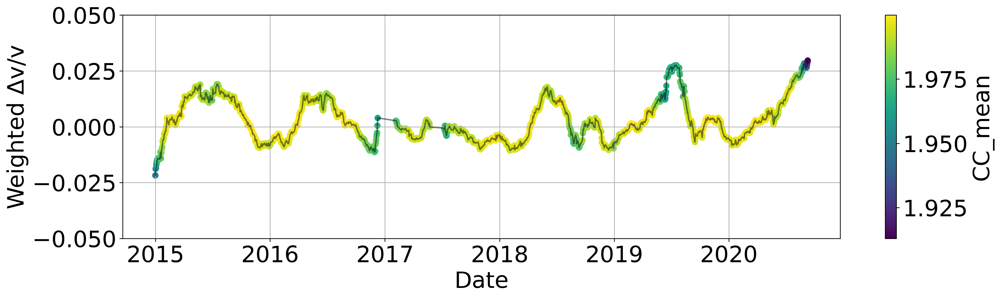

In [262]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    '14_60daystack_1p0to3p0 positiveZE 515svd7x.csv',
    '14_60daystack_1p0to3p0 negativeZE 155svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, -1, 1, -1, -1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2017-04-25")
end_date = pd.to_datetime("2017-06-08")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-11-10")
end_date = pd.to_datetime("2017-01-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(16, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line
z = np.polyfit(weighted_dvv_df.index.astype(np.int64), weighted_dvv_df['Weighted Δv/v'], 1)
p = np.poly1d(z)
plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.05,0.05])
plt.ylabel('Weighted Δv/v')
plt.grid(True)
plt.rcParams.update({'font.size': 15})  # Increase font size
#start_date = pd.to_datetime("2010-07-01")
#end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

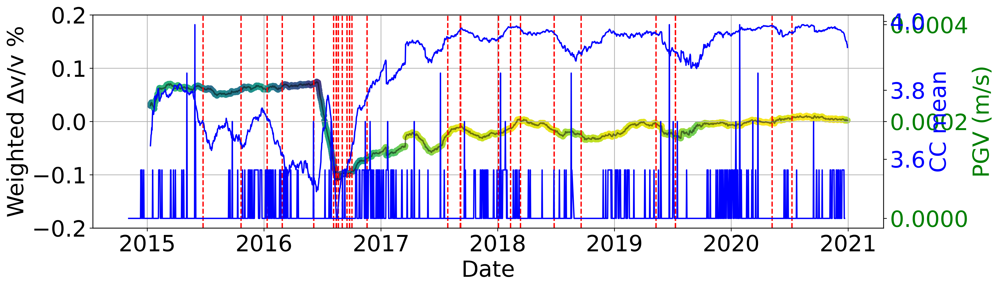

In [93]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_3p0to5p0 negativeZE 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZE 210svd7x.csv',
    'B1_60daystack_3p0to5p0 negativeZN 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZN 210svd7x.csv'
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-12-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Load the PGV data
pgv_df = pd.read_csv('pgv_results_new.csv')
pgv_df['date'] = pd.to_datetime(pgv_df['Date'])  # Adjust 'date' if necessary based on the actual column name
pgv_df.set_index('date', inplace=True)
pgv_df.sort_index(inplace=True)



# Plotting the weighted Δv/v time series with PGV on a separate y-axis
fig, ax1 = plt.subplots(figsize=(16, 5), dpi=300)

# Scatter plot for Δv/v with color coding by CC_mean
sc = ax1.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
ax1.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Line plot to connect markers
ax1.set_xlabel('Date')
ax1.set_ylabel('Weighted Δv/v %')
ax1.set_ylim([-0.2, 0.2])
ax1.grid(True)
plt.rcParams.update({'font.size': 25})  # Increase font size

# Create a secondary y-axis for PGV
ax2 = ax1.twinx()
ax2.plot(pgv_df.index[pgv_df.PGV<0.0005],pgv_df.PGV[pgv_df.PGV<0.0005], color='blue', label='PGV (m/s)')
ax2.set_ylabel('PGV (m/s)', color='green')
ax2.tick_params(axis='y', labelcolor='green')

ax2 = ax1.twinx()
ax2.plot(weighted_dvv_df.index, CC_mean, color='blue', label='CC mean')
ax2.set_ylabel('CC mean', color='blue')
ax2.tick_params(axis='y', labelcolor='blue')

for dt in datetime_objects:
    ax1.axvline(x=dt, color='red', linestyle='--')

# Add color bar for CC_mean
#cbar = fig.colorbar(sc, ax=ax1, label='CC_mean')
plt.rcParams.update({'font.size': 25})
# Show the plot
fig.tight_layout()
plt.show()


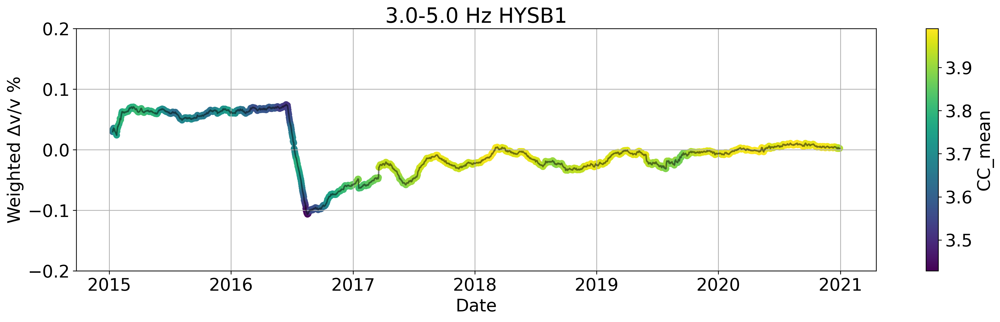

In [21]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_3p0to5p0 negativeZE 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZE 210svd7x.csv',
    'B1_60daystack_3p0to5p0 negativeZN 102svd7x.csv',
    'B1_60daystack_3p0to5p0 positiveZN 210svd7x.csv'
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-12-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)

# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])
weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Load the PGV data
pgv_df = pd.read_csv('pgv_results_new.csv')
pgv_df['date'] = pd.to_datetime(pgv_df['Date'])  # Adjust 'date' if necessary based on the actual column name
pgv_df.set_index('date', inplace=True)
pgv_df.sort_index(inplace=True)



# Plotting the weighted Δv/v time series with PGV on a separate y-axis
fig, ax1 = plt.subplots(figsize=(16, 5), dpi=300)

# Scatter plot for Δv/v with color coding by CC_mean
sc = ax1.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
ax1.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Line plot to connect markers
ax1.set_xlabel('Date')
ax1.set_ylabel('Weighted Δv/v %')
ax1.set_ylim([-0.2, 0.2])
ax1.grid(True)
#plt.rcParams.update({'font.size': 18})  # Increase font size

plt.colorbar(sc, label='CC_mean')
plt.title('3.0-5.0 Hz HYSB1')

# Add color bar for CC_mean
#cbar = fig.colorbar(sc, ax=ax1, label='CC_mean')
plt.rcParams.update({'font.size': 18})
# Show the plot
fig.tight_layout()
plt.show()


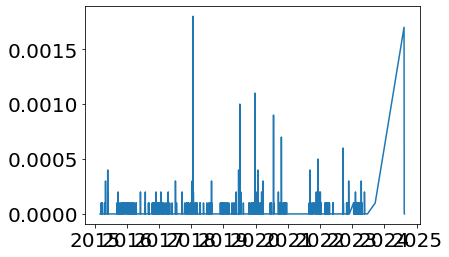

In [19]:
plt.plot(figsize=(16, 5), dpi=300)
plt.plot(pgv_df.index[pgv_df.PGV<0.002],pgv_df.PGV[pgv_df.PGV<0.002])
# Add color bar for CC_mean
#cbar = fig.colorbar(sc, ax=ax1, label='CC_mean')
plt.rcParams.update({'font.size': 25})
# Show the plot
fig.tight_layout()
plt.show()


In [36]:
from datetime import datetime
#Tdates= ['2015-06-24 22:25:29.343674','2015-10-21 07:10:22.988772','2016-01-10 21:12:28.836671','2016-02-27 12:03:06.102124','2016-06-04 14:36:16.085195','2016-06-04 14:37:36.094455','2016-08-05 16:32:06.889686','2016-08-14 00:35:30.246556','2016-08-14 14:38:36.101401','2016-08-20 22:07:09.216344','2016-09-01 15:43:16.550527','2016-09-17 02:04:20.863526','2016-09-17 02:08:10.890149','2016-09-24 18:19:27.635143','2016-09-25 03:22:01.402940','2016-09-25 03:24:51.422618','2016-10-02 12:07:35.052668','2016-11-18 05:22:02.236370','2017-07-29 04:03:41.692326','2017-09-06 10:28:44.366246','2017-09-06 13:01:05.424239','2017-09-06 13:13:25.509897','2017-09-06 13:15:45.526103','2017-09-06 13:19:15.550411','2017-09-06 13:48:05.750666','2017-09-06 13:55:55.805070','2017-09-06 13:58:15.821276','2017-09-06 14:06:35.879153','2017-09-06 14:10:55.909249','2017-09-06 14:31:06.049311','2017-09-06 14:47:16.161593','2017-09-06 15:14:26.350272','2017-09-06 15:32:06.472971','2017-09-06 16:52:17.029749','2017-09-06 17:02:57.103831','2017-09-06 17:04:37.115407','2017-09-06 17:06:47.130455','2017-09-06 17:37:27.343443','2018-01-03 15:22:06.403519','2018-02-10 14:43:16.133812','2018-03-13 15:48:13.211856','2018-06-26 12:51:25.357102','2018-06-26 13:01:05.424239','2018-09-19 07:27:03.104526','2019-05-11 05:18:53.169843','2019-07-11 03:20:01.777251','2019-07-11 03:32:31.888329','2019-07-11 03:46:02.008294','2020-05-08 09:41:54.040977','2020-07-09 09:30:43.963422']#,'2022-02-12 03:54:41.629818','2022-04-22 23:23:09.744183','2022-08-21 18:37:17.759000','2022-10-28 00:42:20.294016','2023-01-29 16:30:26.878111','2023-02-27 13:00:45.421924','2023-05-05 06:52:22.863757']
datetime_objects = [datetime.strptime(date, '%Y-%m-%d %H:%M:%S.%f') for date in Tdates]

In [35]:
Tdates = ['2015-06-24 22:25:29.343674',
           '2015-10-21 07:10:22.988772',
           '2016-01-10 21:12:28.836671',
           '2016-02-27 12:03:06.102124',
           '2016-06-04 14:36:16.085195',
           '2016-06-04 14:37:36.094455',
           '2016-08-05 16:32:06.889686',
           '2016-08-14 00:35:30.246556',
           '2016-08-14 14:38:36.101401',
           '2016-08-20 22:07:09.216344',
           '2016-09-01 15:43:16.550527',
           '2016-09-17 02:04:20.863526',
           '2016-09-17 02:08:10.890149',
           '2016-09-24 18:19:27.635143',
           '2016-09-25 03:22:01.402940',
           '2016-09-25 03:24:51.422618',
           '2016-10-02 12:07:35.052668',
           '2016-11-18 05:22:02.236370',
           '2017-07-29 04:03:41.692326',
           '2017-09-06 10:28:44.366246',
           '2017-09-06 13:01:05.424239',
           '2017-09-06 13:13:25.509897',
           '2017-09-06 13:15:45.526103',
           '2017-09-06 13:19:15.550411',
           '2017-09-06 13:48:05.750666',
           '2017-09-06 13:55:55.805070',
           '2017-09-06 13:58:15.821276',
           '2017-09-06 14:06:35.879153',
           '2017-09-06 14:10:55.909249',
           '2017-09-06 14:31:06.049311',
           '2017-09-06 14:47:16.161593',
           '2017-09-06 15:14:26.350272',
           '2017-09-06 15:32:06.472971',
           '2017-09-06 16:52:17.029749',
           '2017-09-06 17:02:57.103831',
           '2017-09-06 17:04:37.115407',
           '2017-09-06 17:06:47.130455',
           '2017-09-06 17:37:27.343443',
           '2018-01-03 15:22:06.403519',
           '2018-02-10 14:43:16.133812',
           '2018-03-13 15:48:13.211856',
           '2018-06-26 12:51:25.357102',
           '2018-06-26 13:01:05.424239',
           '2018-09-19 07:27:03.104526',
           '2019-05-11 05:18:53.169843',
           '2019-07-11 03:20:01.777251',
           '2019-07-11 03:32:31.888329',
           '2019-07-11 03:46:02.008294',
           '2020-05-08 09:41:54.040977',
           '2020-07-09 09:30:43.963422',
           '2022-02-12 03:54:41.629818',
           '2022-04-22 23:23:09.744183',
           '2022-08-21 18:37:17.759000',
           '2022-10-28 00:42:20.294016',
           '2023-01-29 16:30:26.878111',
           '2023-02-27 13:00:45.421924',
           '2023-05-05 06:52:22.863757']

(0.95, 1.0)

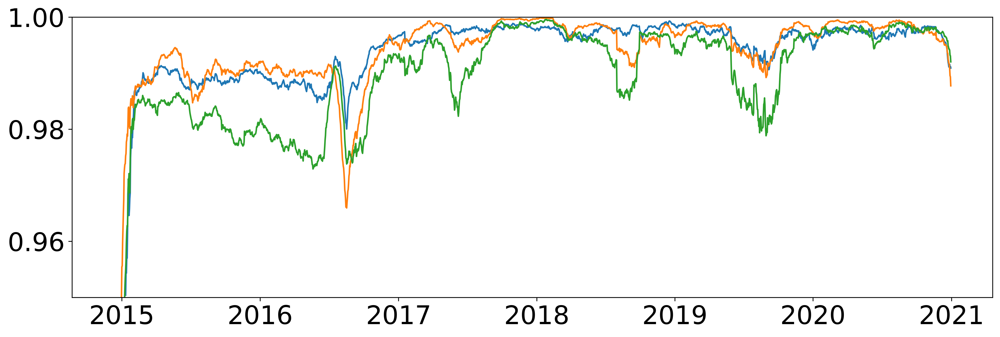

In [76]:
fig = plt.figure(figsize=(16, 5), dpi=300)
#plt.plot(weighted_dvv_df.index,interpolated_dfs[0].CCT)
plt.plot(weighted_dvv_df.index,interpolated_dfs[1].CCT)
plt.plot(weighted_dvv_df.index,interpolated_dfs[2].CCT)
plt.plot(weighted_dvv_df.index,interpolated_dfs[3].CCT)
plt.ylim([0.95,1])

In [66]:
interpolated_dfs[0].CCT

2014-11-11         NaN
2014-11-12         NaN
2014-11-13         NaN
2014-11-14         NaN
2014-11-15         NaN
                ...   
2020-11-26    0.993962
2020-11-27    0.994259
2020-11-28    0.993745
2020-11-29    0.992661
2020-11-30    0.991238
Name: CCT, Length: 2212, dtype: float64

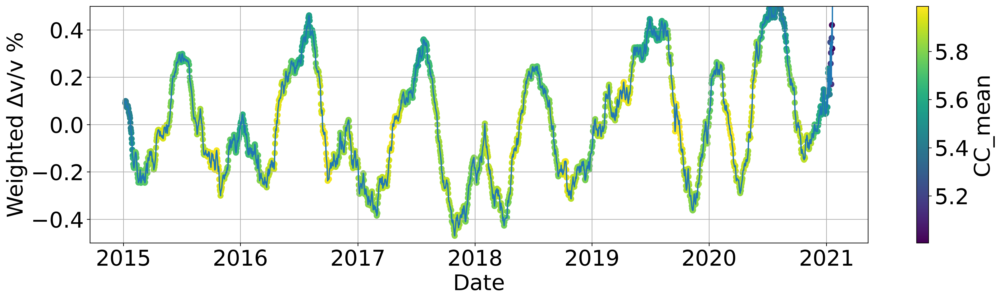

In [35]:
# import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_0p1to0p3 positiveZN 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeZN 6010svd7x.csv',
    'B1_60daystack_0p1to0p3 positiveNE 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeNE 6010svd7x.csv',
    'B1_60daystack_0p1to0p3 positiveZE 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeZE 6010svd7x.csv'
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1, 1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)

# Fourier Transform, filter seasonal components, and Inverse Fourier Transform
def remove_seasonality(df, column, low_freq, high_freq):
    fft = np.fft.fft(df[column])
    frequencies = np.fft.fftfreq(len(df))
    filter_mask = (frequencies < low_freq) | (frequencies > high_freq)
    filtered_fft = fft * filter_mask
    filtered_signal = np.fft.ifft(filtered_fft).real
    df[column] = filtered_signal
    return df

# Define the frequency range to filter out (e.g., around 1/365 for annual cycles)
low_freq = 1 / 400
high_freq = 1 / 330

# Apply the seasonality removal to each dataframe
#for df in dataframes:
#    df = remove_seasonality(df, 'DVT', low_freq, high_freq)

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2023-10-01")
end_date = pd.to_datetime("2024-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].index[(interpolated_dfs[i].index >= start_date) & (interpolated_dfs[i].index <= end_date)])

start_date = pd.to_datetime("2010-01-10")
end_date = pd.to_datetime("2011-02-05")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].index[(interpolated_dfs[i].index >= start_date) & (interpolated_dfs[i].index <= end_date)])

# Calculate CC_mean using squared correlation coefficients for each dataframe
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted dv/v using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs)

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted dv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted dv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted dv/v time series with color-coded CC_mean
plt.figure(figsize=(20, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted dv/v'], c=CC_mean, cmap=cmap, norm=norm)
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted dv/v'], linestyle='-', marker=None)
plt.colorbar(sc, label='CC_mean')
# Adding a trend line
plt.grid(True)
plt.xlabel('Date')
plt.ylim(-0.5, 0.5)
plt.ylabel('Weighted Δv/v %')
plt.show()

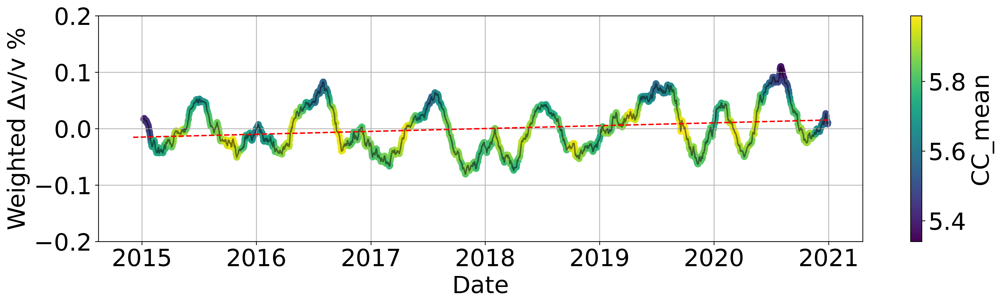

In [52]:
# import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm


# Define the paths to your CSV files
file_paths = [
    'B1_60daystack_0p1to0p3 positiveZN 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeZN 6010svd7x.csv',
    'B1_60daystack_0p1to0p3 positiveNE 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeNE 6010svd7x.csv',
    'B1_60daystack_0p1to0p3 positiveZE 1060svd7x.csv',
    'B1_60daystack_0p1to0p3 negativeZE 6010svd7x.csv',
]

# Predefined array with multipliers (-1 or +1)
multipliers = [1,1, 1, 1, 1, 1]

dataframes = []
for path, multiplier in zip(file_paths, multipliers):
    df = pd.read_csv(path)
    df['DVT'] *= multiplier  # Apply the multiplier to the DVT column
    dataframes.append(df)

# Parse timestamps and set them as the index
for df in dataframes:
    df['T'] = pd.to_datetime(df['T'])
    df.set_index('T', inplace=True)
    
    

# Create a unified time index from the union of all timestamps in the dataframes
unified_index = pd.to_datetime(sorted(set.union(*(set(df.index) for df in dataframes))))

# Interpolate data for each dataframe to match the unified index
interpolated_dfs = [df.reindex(unified_index).interpolate() for df in dataframes]

# Define the date range to exclude
start_date = pd.to_datetime("2020-12-01")
end_date = pd.to_datetime("2021-01-30")

# Exclude the specified date range
for i in range(len(interpolated_dfs)):
    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
start_date = pd.to_datetime("2016-11-10")
end_date = pd.to_datetime("2017-01-05")

# Exclude the specified date range
#for i in range(len(interpolated_dfs)):
#    interpolated_dfs[i] = interpolated_dfs[i].drop(interpolated_dfs[i].loc[start_date:end_date].index)
    
# Calculate CC_mean using squared correlation coefficients for each time point
CC_mean = sum(df['CCT']**2 for df in interpolated_dfs)

# Calculate weighted Δu/u using squared CCT and DVT
weighted_dvv = sum(df['CCT']**2 * df['DVT'] for df in interpolated_dfs) / CC_mean

# Normalize CC_mean for coloring
norm = mcolors.Normalize(vmin=CC_mean.min(), vmax=CC_mean.max())
cmap = cm.viridis  # Can choose any available colormap

# Create a DataFrame for the weighted Δv/v time series
weighted_dvv_df = pd.DataFrame(weighted_dvv, columns=['Weighted Δv/v'])

weighted_dvv_df.index = weighted_dvv_df.index + pd.DateOffset(days=30)

# Plotting the weighted Δv/v time series with color-coded CC_mean
plt.figure(figsize=(16, 5), dpi=300)
# Scatter plot for individual markers with color coding
sc = plt.scatter(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], c=CC_mean, cmap=cmap, norm=norm, label='Weighted Δv/v')
# Line plot to connect markers
plt.plot(weighted_dvv_df.index, weighted_dvv_df['Weighted Δv/v'], 'k-', alpha=0.5)  # Adjust alpha for line transparency
plt.colorbar(sc, label='CC_mean')
# Adding a trend line

#plt.title('Weighted Δv/v For HYS14 1.0-3.0Hz Combined')
plt.xlabel('Date')
plt.ylim([-0.2,0.2])
plt.ylabel('Weighted Δv/v %')
plt.grid(True)

cleaned_df = weighted_dvv_df.dropna(subset=['Weighted Δv/v'])

# Convert index to int64
index_as_int = cleaned_df.index.astype(np.int64)

# Perform the polynomial fit
z = np.polyfit(index_as_int, cleaned_df['Weighted Δv/v'], 1)
p = np.poly1d(z)

plt.plot(weighted_dvv_df.index, p(weighted_dvv_df.index.astype(np.int64)), "r--", label='Trend Line')
#start_date = pd.to_datetime("2010-07-01")
#end_date = pd.to_datetime("2024-03-01")
plt.rcParams.update({'font.size': 25})
#plt.xlim([start_date, end_date])
plt.xticks()
plt.tight_layout()
plt.show()

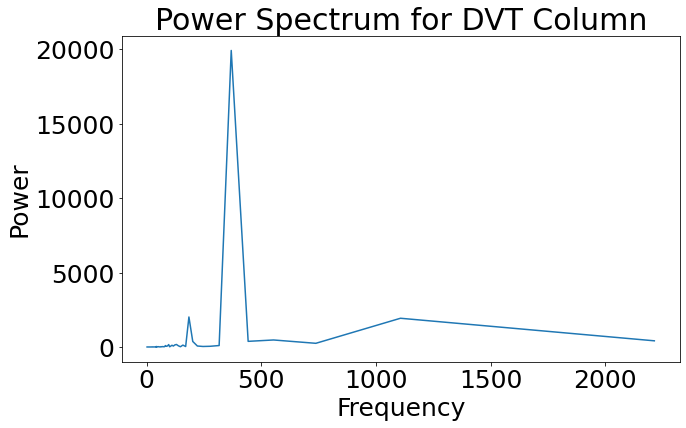

369.0

In [51]:
import pandas as pd
import numpy as np
from scipy.fft import fft, fftfreq
import matplotlib.pyplot as plt

# Load the CSV file
file_path = 'B1_60daystack_0p1to0p3 positiveZE 1060svd7x.csv'
data = pd.read_csv(file_path)

# Convert the 'T' column to datetime format
data['T'] = pd.to_datetime(data['T'])

# Sort data by time in case it's not sorted
data = data.sort_values('T')

# Extract the numerical values from the 'DVT' column
dvt_values = data['DVT'].values

# Perform FFT
n = len(dvt_values)
dvt_fft = fft(dvt_values)
frequencies = fftfreq(n)

# Get the power spectrum
power_spectrum = np.abs(dvt_fft)**2

# Identify the dominant frequencies
# We will consider the positive frequencies only and ignore the zero frequency
positive_frequencies = frequencies[frequencies > 0]
positive_power_spectrum = power_spectrum[frequencies > 0]

# Identify the index of the peak in the power spectrum
dominant_frequency_idx = np.argmax(positive_power_spectrum)
dominant_frequency = positive_frequencies[dominant_frequency_idx]

# Convert the dominant frequency to the period
dominant_period = 1 / dominant_frequency

# Plot the power spectrum
plt.figure(figsize=(10, 6))
plt.plot(1/positive_frequencies, positive_power_spectrum)
plt.xlabel('Frequency')
plt.ylabel('Power')
plt.title('Power Spectrum for DVT Column')
plt.show()

dominant_period


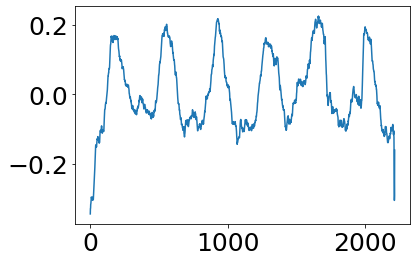

In [54]:
plt.plot(dvt_values)